In [1]:
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt
from os import listdir, path
%matplotlib inline

imagesnames = sorted(listdir('images'))   
print(sorted(imagesnames))


['.DS_Store', '.ipynb_checkpoints', 'blurry_moon.png', 'ckt_board_saltpep_prob_pt05.png', 'contact_lens_original.png', 'darkPollen.jpg', 'face.png', 'g.jpg', 'jiraffe.jpg', 'lena.jpg', 'lightPollen.jpg', 'lowContrastPollen.jpg', 'pollen.jpg', 'poomesa.jpg', 'runway.jpg', 'spine.jpg', 'test_pattern_blurring_orig.png', 'tgle.jpg', 'university.png', 'z1.jpg', 'z2.jpg', 'z3.jpg', 'z4.jpg', 'z5.jpg', 'z6.jpg', 'z7.jpg', 'zzspine.jpg']


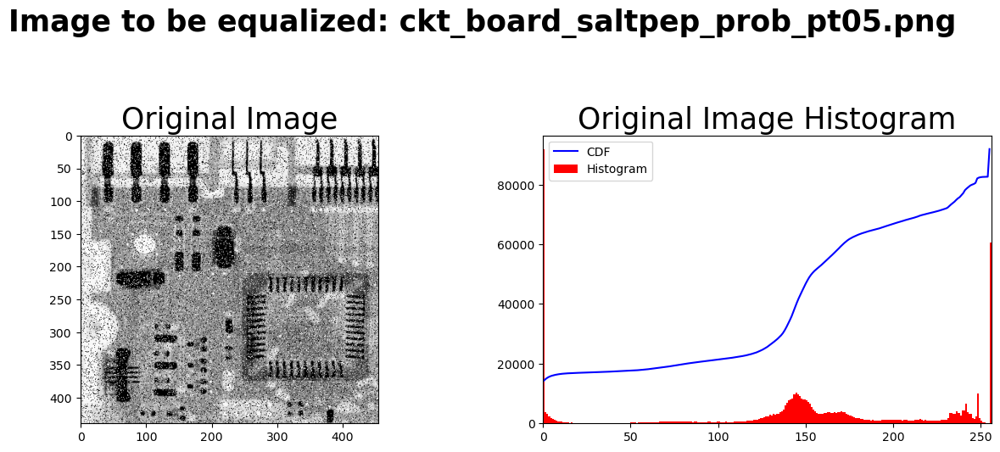

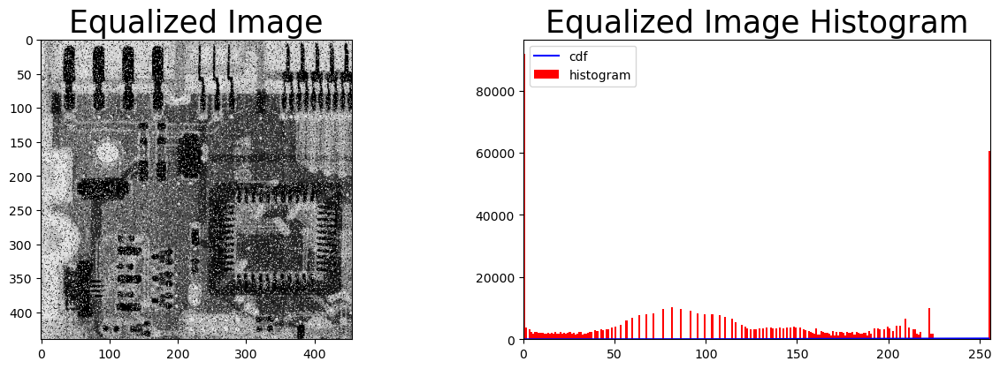

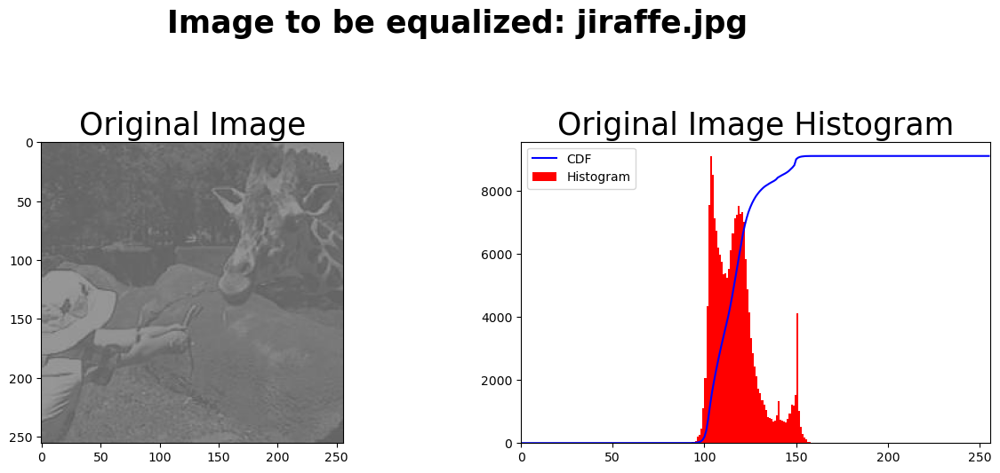

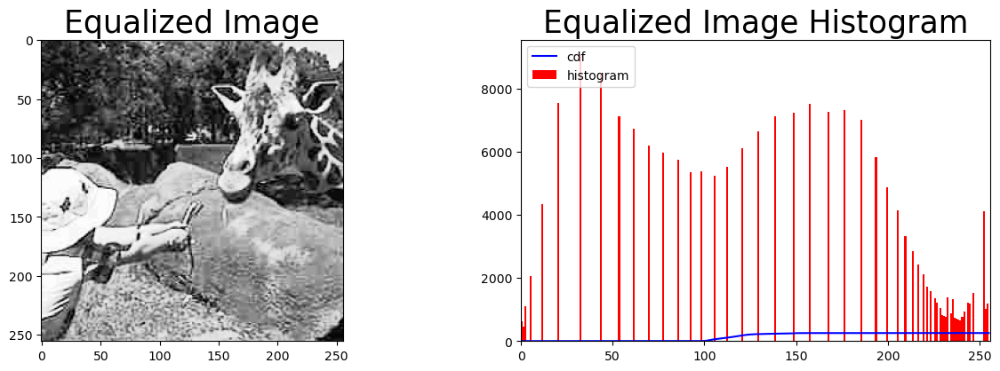

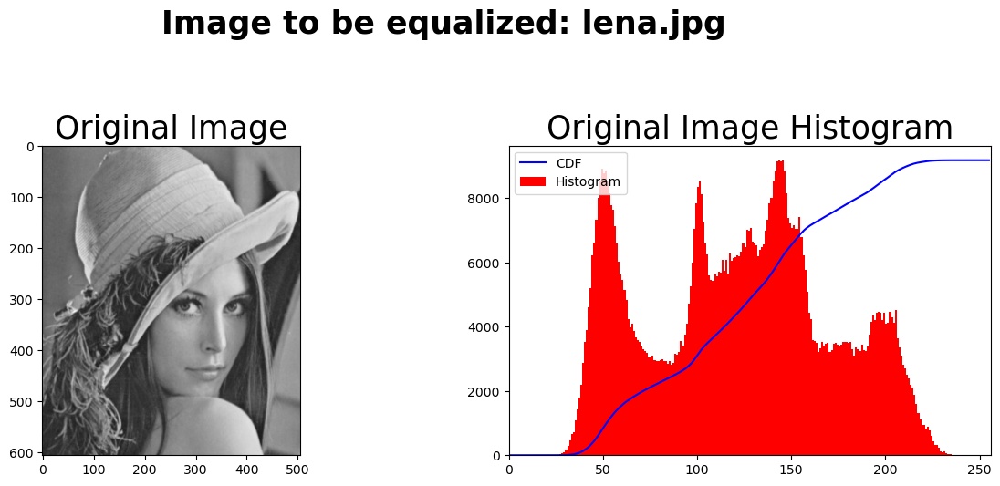

...

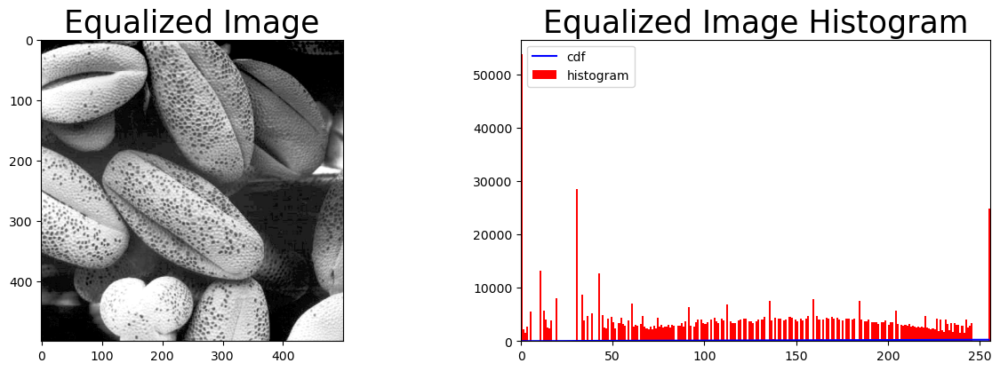

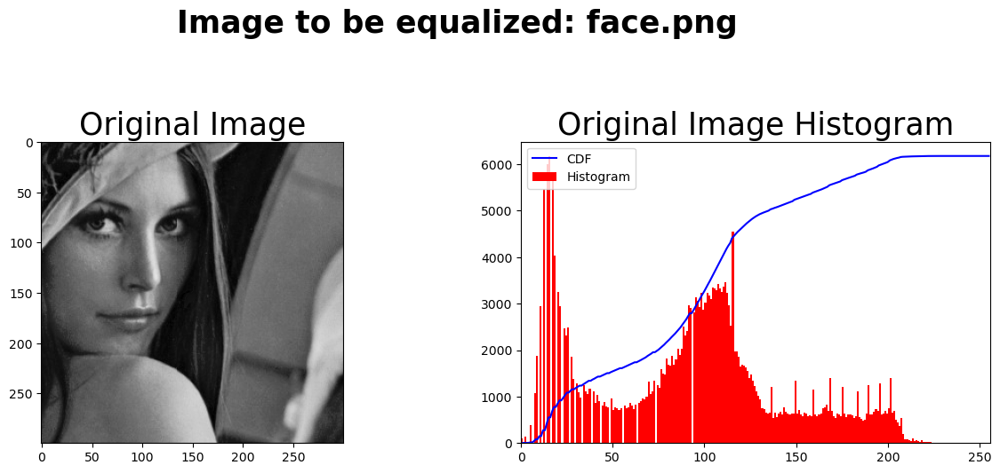

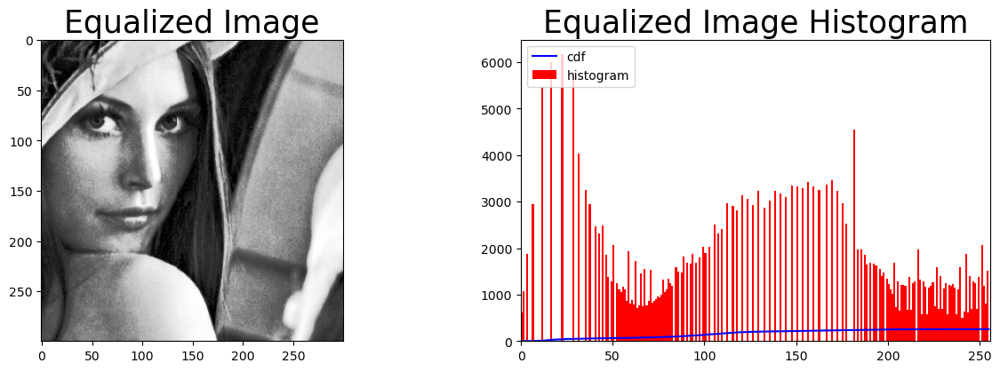

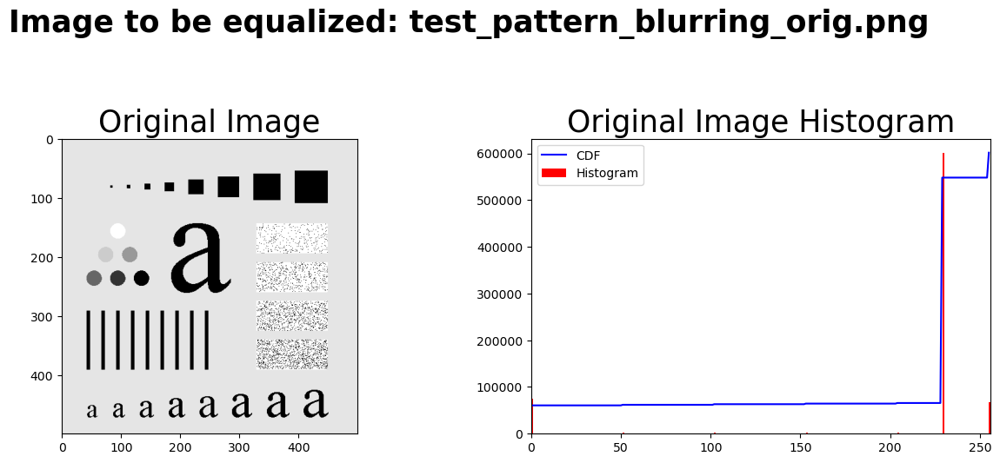

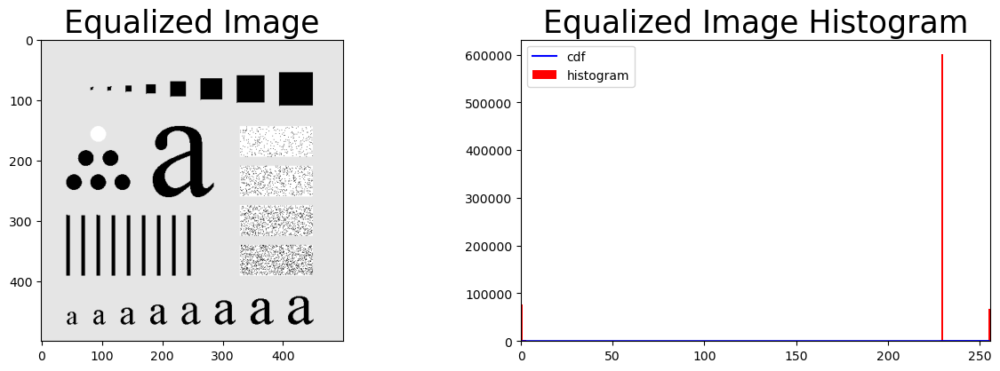

In [2]:
#Define function
def equalize_image(src):
        hist,bins = np.histogram(src.flatten(),256,[0,256])    #For making histogram, the input data needs to be 
        #flatten which converts a matrix in one single array 
        cdf = hist.cumsum()  #Function that returns the cumulative sum of the elements along a given array.
        cdf_normalized = cdf * hist.max()/ cdf.max()   #normalize cumulative distribution function
        plt.title('Original Image Histogram',fontsize=25);
        plt.plot(cdf_normalized, color = 'b');   #Plot cdf normalized in blue color
        plt.hist(src.flatten(),256,[0,256], color = 'r')  #plot histogram of image in red color
        plt.xlim([0,256])   #define x lim
        plt.legend(('CDF','Histogram'), loc = 'upper left')   #Place legend at the upper left side of the figure
        #plt.show()  #Show both histogram and cdf 
        cdf_t= np.ma.masked_equal(cdf,0)   #Since pixels values of 0 do not contribute to an increase in the cdf
        #they were excluded using a mask array which replaces 0 pixel values in the specified array with --
        cdf_t = (cdf_t - cdf_t.min())*255/(cdf_t.max()-cdf_t.min())  #Transformation
        cdf = np.ma.filled(cdf_t,0).astype('uint8')  #Fill elements that corresponds to masked data with a fill value
        #cdf corresponds to a look up table that provides the information of the output pixel value for every input pixel value.
        return [cdf[src],cdf]  #This applies the transform and returns it and it also returns the cdf.

#Read images for further processing
img1 = cv2.imread("images/"+imagesnames[3],1)  
img2 = cv2.imread("images/"+imagesnames[8],1) 
img3 = cv2.imread("images/"+imagesnames[9],1) 
img4 = cv2.imread("images/"+imagesnames[10],1)  
img5 = cv2.imread("images/"+imagesnames[24],1)  
img6 = cv2.imread("images/"+imagesnames[12],1)  
img7 = cv2.imread("images/"+imagesnames[6],1)  
img8 = cv2.imread("images/"+imagesnames[16],1)  
vector_sources = [img1,img2,img3,img4,img5,img6,img7,img8]     #Save in a new array read images in order to make more easy plotting, titling and calling defined functions 
vector_names = [imagesnames[3],imagesnames[8],imagesnames[9],imagesnames[10],imagesnames[24],imagesnames[12],imagesnames[6],imagesnames[16]]  #Save the images names in this array

#Test function
for i,img_name in enumerate(vector_names):#Go over array with images names
    plt.figure(figsize=(15,15));
    plt.suptitle("Image to be equalized: "+ img_name, fontsize=25,fontweight='bold')  #Title every section of images
    plt.subplot(3,2,1);  #Create subplot
    plt.title('Original Image',fontsize=25);   
    plt.imshow(vector_sources[i]); #Plot original image
    plt.subplot(3,2,2);  #Create subplot
    imgequalized,cdft= equalize_image(vector_sources[i]) #Call function that returns both equalized image and cdf
    plt.figure(figsize=(15,15));
    plt.subplot(3,2,1);
    plt.title('Equalized Image',fontsize=25);
    plt.imshow(imgequalized);    #Plot equalized image
    plt.subplot(3,2,2);
    plt.title('Equalized Image Histogram',fontsize=25);  
    plt.plot(cdft, color = 'b') #Plot cumulative distribution function of equalized image
    plt.hist(imgequalized.flatten(),256,[0,256], color = 'r')   #Plot histogram of equalized image
    plt.xlim([0,256])
    plt.legend(('cdf','histogram'), loc = 'upper left')  #Place legend in upper left side of histogram
    plt.show()
    

- Описание разработанной функции:

Функция equalize_image, разработанная в этом разделе, принимает в качестве единственного входного значения исходное изображение для обработки и возвращает два выходных значения: выровненное изображение и кумулятивную функцию распределения этого изображения. Внутренняя обработка этой функции основана на теории выравнивания гистограммы, которая в общих чертах достигается за счет регулировки контрастности исходного изображения.

Выравнивание гистограммы обычно используется, когда значения пикселей изображения ограничены только определенным диапазоном значений, что обычно происходит в изображениях с фоном и передним планом, которые являются одновременно яркими или темными. В этом случае необходима функция преобразования, которая растягивает гистограмму до конца, чтобы, таким образом, получить изображение с пикселями из всех областей гистограммы. Это можно было бы лучше понять, рассматривая следующее изображение:

Взято из: http://docs.opencv.org/3.1.0/d5/daf/tutorial_py_histogram_equalization.html

Как показано на этом рисунке, выравнивание гистограммы позволяет лучше распределить интенсивности изображения на гистограмме, что не только упрощает дальнейшую обработку, но и улучшает ее визуальное качество.
- Описание библиотечных функций, используемых в этом разделе:

Чтобы успешно достичь цели этого раздела, необходимо было использовать несколько функций библиотеки OPENCV и NUMPY. Среди этих функций использовалась .flatten() из библиотеки NUMPY, которая возвращает копию исходного массива (в данном случае изображения), свернутого в одно измерение, что необходимо для создания гистограммы. Для построения гистограммы также использовалась функция NUMPY, np.histogram(), которая получает три параметра в качестве входных данных: сглаженный массив (сглаженное изображение), количество ячеек одинаковой ширины в заданном диапазоне и диапазон ячеек. . Затем использовалась функция hist.cumsum(), которая вычисляет кумулятивную сумму элементов по заданному массиву, что в данном случае соответствует кумулятивной функции распределения. Полученное значение нормировали путем умножения его на максимальное значение ранее построенной гистограммы и деления на максимальное значение интегральной функции распределения. После этого отображаются только что определенные гистограмма и cdf с использованием функции графика библиотеки MATPLOTLIB и указанием легенды в верхней левой части графика, чтобы отличать cdf от гистограммы. Однако функция в этот момент не выравнивает гистограмму, по-прежнему требуется функция преобразования, которая отображает входные пиксели в области, в которой они находятся, для вывода пикселей в полной области гистограммы. Поскольку значения пикселей, равные 0, не способствуют увеличению cdf, они исключаются с помощью функции «np.ma.masked_equal()» из библиотеки NUMPY. Эта функция получает два параметра: массив и маскируемое значение. Это означает, что эта функция в основном выполняет маску, ГДЕ выполняется условие «x == значение». Когда это значение опущено, применяется необходимое преобразование. Но в этом преобразованном массиве все еще есть замаскированные значения, поэтому их нужно снова заполнить 0, чтобы успешно выполнить упомянутое ранее сопоставление. Для выполнения этой задачи использовался np.ma.filled() из библиотеки NUMPY. Эта функция получает два параметра: замаскированный массив и значение заполнения для замаскированных данных. Наконец, используется цикл для построения каждого исходного изображения, вызова определенной функции, построения выровненного изображения и построения обеих гистограмм.


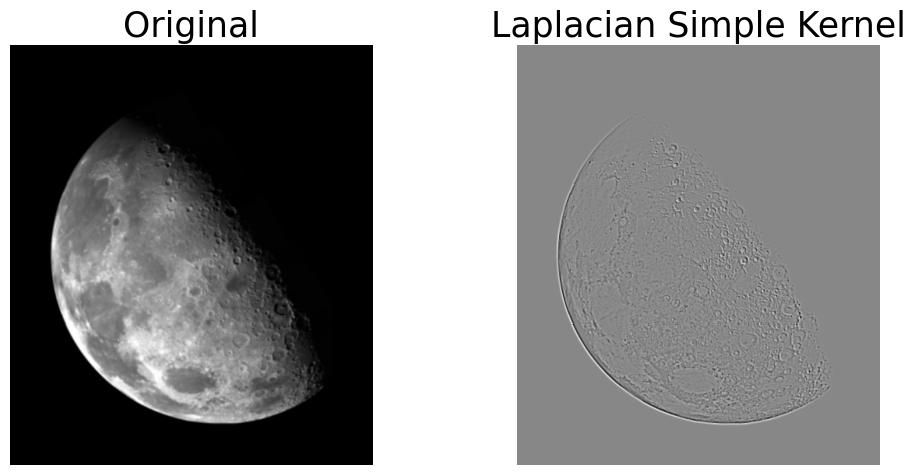

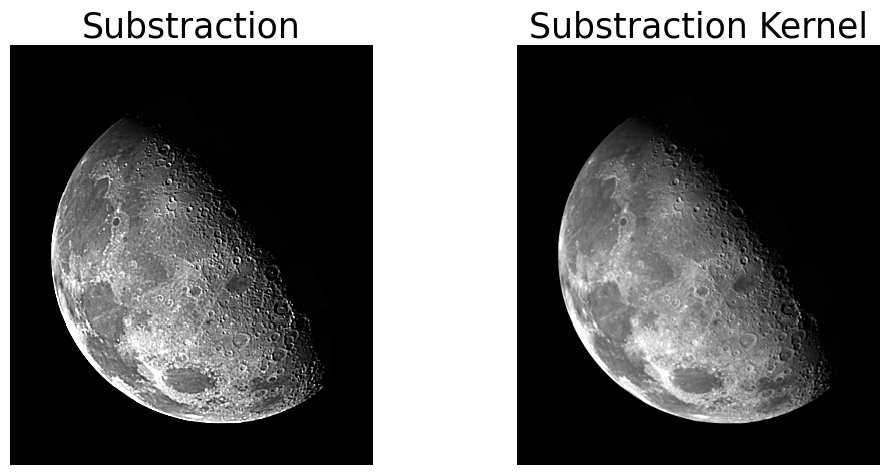

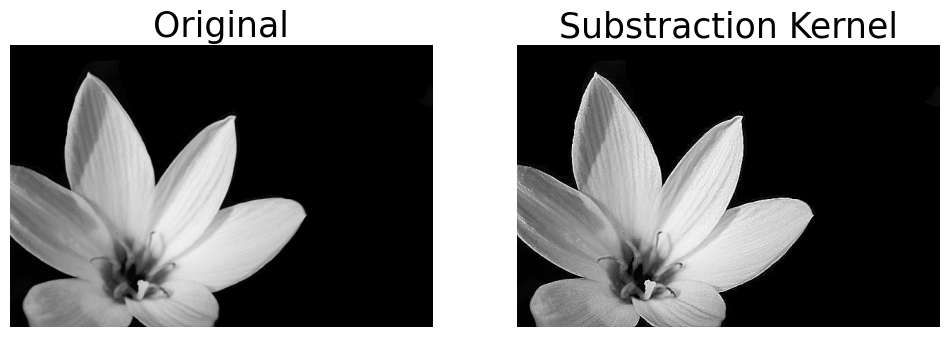

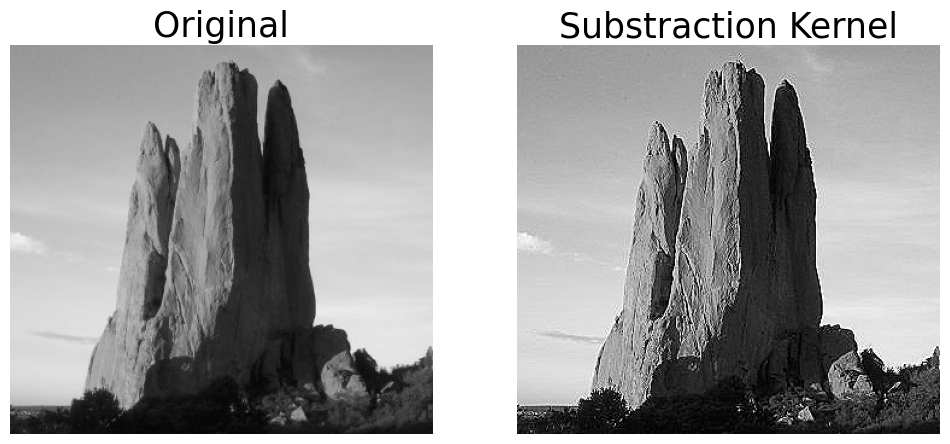

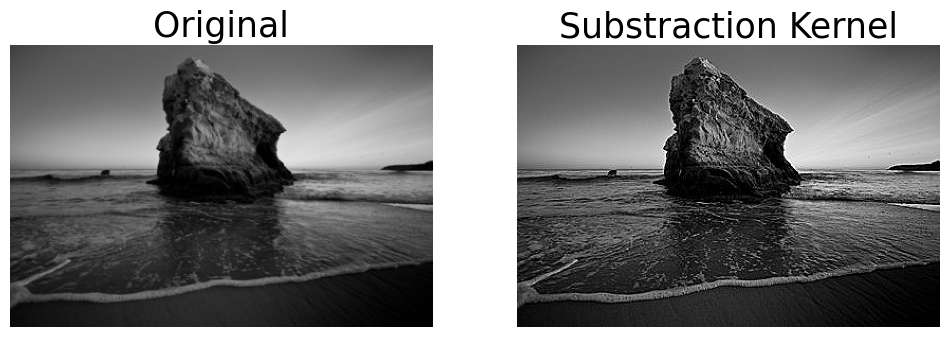

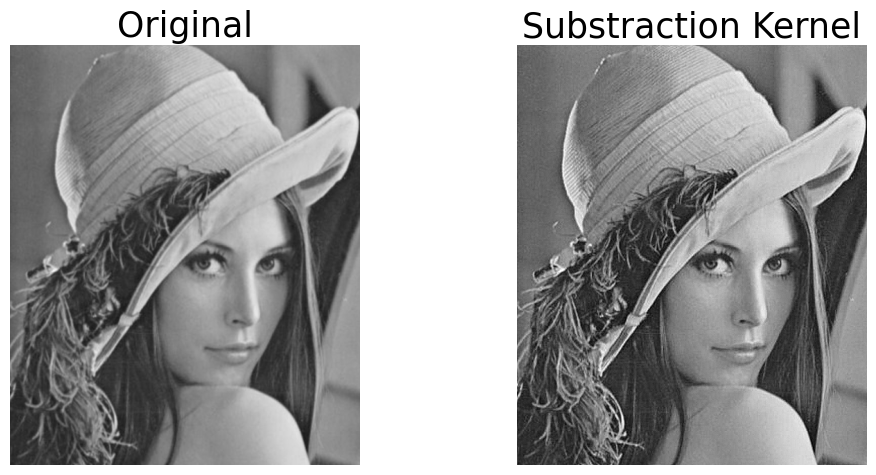

In [3]:

#Define Function

# Subtraction and laplacian
def Subtraction_Lap(img): #Function to apply the substraction kernel
    kernel_sub=np.array([[0,-1,0],[-1,5,-1],[0,-1,0]],dtype=np.float32) #Build the substraction kernel
    imgSubK = cv2.filter2D(img,-1,kernel_sub)  #Apply the kernel
    return imgSubK   #Return the result

# Simple Laplacian
def Simple_Laplacian(img):           #Function to apply the Simple Laplacian Kernel
    kernel_S = np.array([[0,1,0],[1,-4,1],[0,1,0]],dtype=np.float32) #Build Simple Laplacian kernel 
    imgSL = cv2.filter2D(img,-1,kernel_S)  #Apply the kernel
    imgSubS=img-imgSL #Do the substraction of the original image and the simple Laplacian
    imgSubS_K=Subtraction_Lap(img) #Apply the substraction kernel
    return [imgSL,imgSubS, imgSubS_K]  #return the laplacian, Substraction_Lap output and the manual substraction

# Variant Laplacian 
def Variant_Laplacian(img): #Function to apply the Variant Kernel
    kernel_V = np.array([[1,1,1],[1,-8,1],[1,1,1]],dtype=np.float32) #Build the Variant Laplacian kernel
    imgVL = cv2.filter2D(img,-1,kernel_V)  #Apply the  kernel
    imgSubV=img-imgVL #Do the substraction of the original image and the variant Laplacian
    imgSubV_K=Subtraction_Lap(img) #Apply the substraction kernel
    return [imgVL,imgSubV,imgSubV_K]   #return the laplacian, Substraction_Lap output and the manual substraction

#Load images
img = cv2.imread ('images/blurry_moon.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Read original image
img_2 = cv2.imread ('images/g.jpg') #Read original image 2
img_5 = cv2.imread ('images/lena.jpg') #Read original image 3
img_3 = cv2.imread ('images/z4.jpg') #Read original image 3
img_4 = cv2.imread('images/z5.jpg')

#Call functions
LaplacianV, subtractionV,subtractionV_K= Variant_Laplacian(img) 
LaplacianV_2, subtractionV_2, subtractionV_K_2= Variant_Laplacian(img_2) 
LaplacianV_3,subtractionV_3, subtractionV_K_3= Variant_Laplacian(img_3) 
LaplacianV_4, subtractionV_4,subtractionV_K_4= Variant_Laplacian(img_4) 
LaplacianV_5, subtractionV_5, subtractionV_K_5= Variant_Laplacian(img_5) 


#Plotting
plt.figure(figsize=(12,12)); 
plt.subplot(2,2,1);plt.imshow(img, cmap='gray');plt.title("Original",fontsize=25);plt.axis('off')           #Display the image
plt.subplot(2,2,2);plt.imshow(LaplacianV,cmap='gray');plt.title("Laplacian Simple Kernel",fontsize=25);plt.axis('off')           #Display the image
plt.figure(figsize=(12,12)); 
plt.subplot(2,2,1); plt.imshow(subtractionV, cmap='gray', vmin=0, vmax=255);plt.title("Substraction",fontsize=25);plt.axis('off')           #Display the image
plt.subplot(2,2,2); plt.imshow(subtractionV_K, cmap='gray', vmin=0, vmax=255);plt.title("Substraction Kernel",fontsize=25);plt.axis('off')           #Display the image
plt.figure(figsize=(12,12)); 
plt.subplot(2,2,1);plt.imshow(img_2, cmap='gray');plt.title("Original",fontsize=25);plt.axis('off')           #Display the image
plt.subplot(2,2,2); plt.imshow(subtractionV_K_2,cmap='gray', vmin=0, vmax=255);plt.title("Substraction Kernel",fontsize=25);plt.axis('off')           #Display the image


plt.figure(figsize=(12,12)); 
plt.subplot(2,2,1);plt.imshow(img_3, cmap='gray');plt.title("Original",fontsize=25);plt.axis('off')           #Display the image
plt.subplot(2,2,2); plt.imshow(subtractionV_K_3, cmap='gray', vmin=0, vmax=255);plt.title("Substraction Kernel",fontsize=25);plt.axis('off')  #Display the image

plt.figure(figsize=(12,12)); 
plt.subplot(2,2,1);plt.imshow(img_4, cmap='gray');plt.title("Original",fontsize=25);plt.axis('off')           #Display the image
plt.subplot(2,2,2); plt.imshow(subtractionV_K_4, cmap='gray', vmin=0, vmax=255);plt.title("Substraction Kernel",fontsize=25);plt.axis('off')  #Display the image

plt.figure(figsize=(12,12)); 
plt.subplot(2,2,1);plt.imshow(img_5, cmap='gray');plt.title("Original",fontsize=25);plt.axis('off')           #Display the image
plt.subplot(2,2,2); plt.imshow(subtractionV_K_5, cmap='gray', vmin=0, vmax=255);plt.title("Substraction Kernel",fontsize=25);plt.axis('off')  #Display the image

plt.show()



- Описание разработанной функции:

Для этого элемента были разработаны три функции. Первая функция, Subtraction_Lap(), получает исходное изображение в качестве входного параметра, применяет лапласиан и ядро вычитания к входному изображению и возвращает обработанное изображение. Вторая функция, Simple_Laplacian(), получает изображение для обработки в качестве входного параметра, применяет ядро лапласиана к входному изображению, вручную вычитает результат из исходного изображения и вызывает функцию Substraction_Lap(). Эта функция имеет три выхода: лапласиан входного изображения, выход Substraction_Lap() и ручное вычитание лапласиана и входного изображения. Наконец, функция Variant_Laplacian() получает изображение для обработки в качестве входного параметра. Эта функция применяет вариант ядра лапласиана к входному изображению для получения лапласиана, вычитает его из изображения, вызывает функцию Substraction_Lap() и возвращает лапласиан, вывод Substraction_Lap() и ручное вычитание полученного лапласиана и входных данных. изображение.

- Описание библиотечных функций, используемых в этом разделе:

Для разработки этого пункта использовались различные функции библиотеки OpenCV, как и ранее упомянутые для чтения и показа изображений. Из используемых функций самой важной в этом пункте была функция "Filter2D()", которая применяет ядро к изображению и возвращает результат. Эта функция получает три входных параметра: исходное изображение, желаемую глубину выходного изображения и применяемое ядро. В разработанных функциях желаемая глубина задается глубиной исходного изображения и ядро вводится в функцию в виде массива с разными значениями в зависимости от конкретной функции.

-Анализ полученных результатов:

Можно заметить, что при применении базового ядра лапласиана к изображению и последующем ручном вычитании лапласиана из исходного изображения результат почти такой же, как и при применении ядра, объединяющего лапласиан и вычитание в исходное изображение. Также следует отметить, что при применении вариантного ядра лучше выделяются детали изображения. Это позволяет определить вариант ядра лапласиана как лучший вариант для получения изображения с более определенными деталями. Наконец, было замечено, что при повторении этого процесса с другими изображениями получаются аналогичные результаты. Иными словами, на полученных изображениях детали оригиналов подчеркнуты гораздо сильнее.



/var/folders/k7/g03ld0113tx0km20ry5r3np40000gn/T/ipykernel_17998/601988000.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(12,12)); plt.subplot(121); plt.imshow(blur, cmap='gray'); plt.title('Averaging Filter '+str(i)+"x"+str(i),fontsize="15");plt.axis('off')


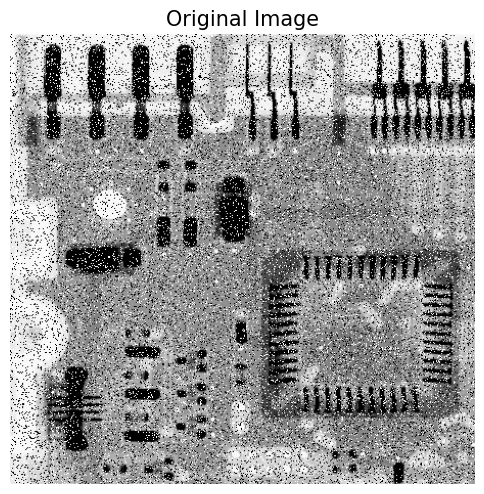

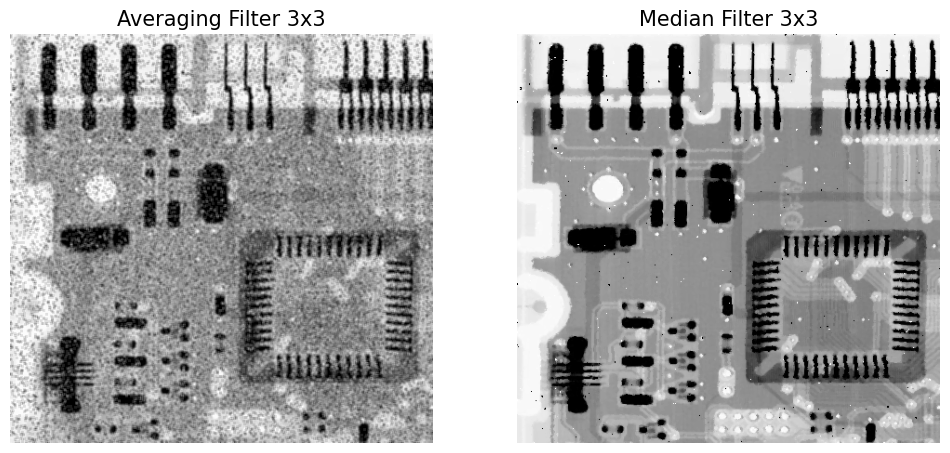

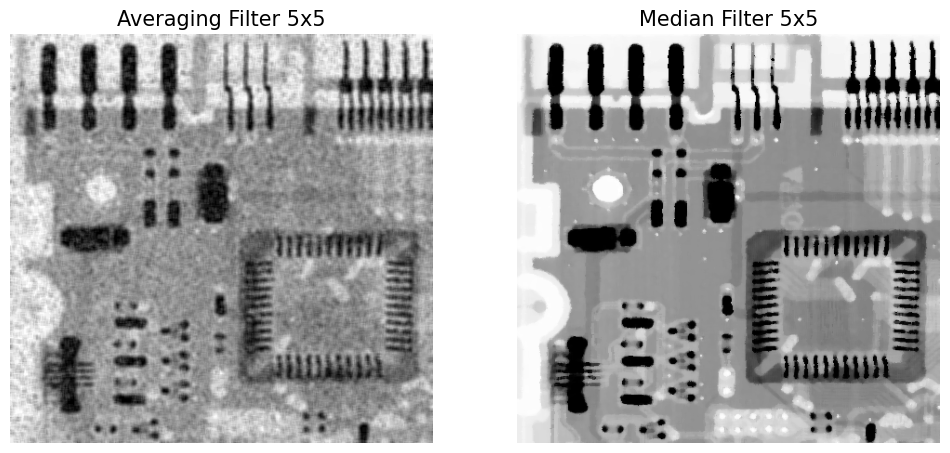

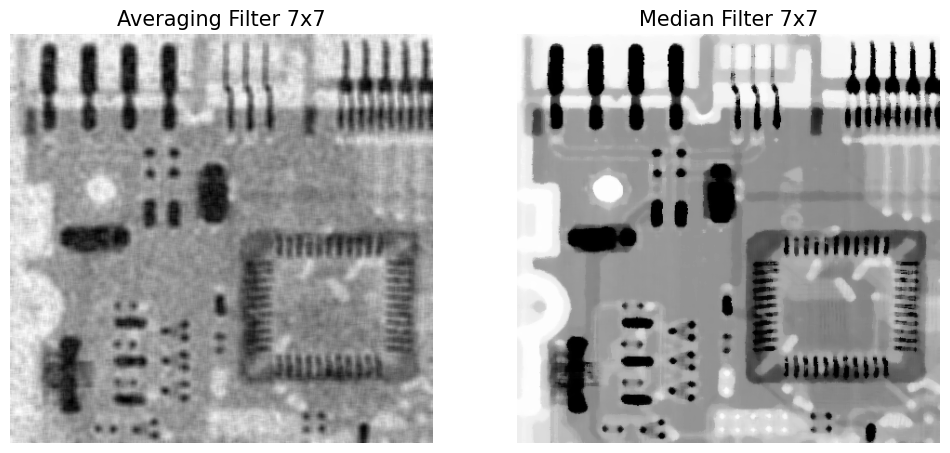

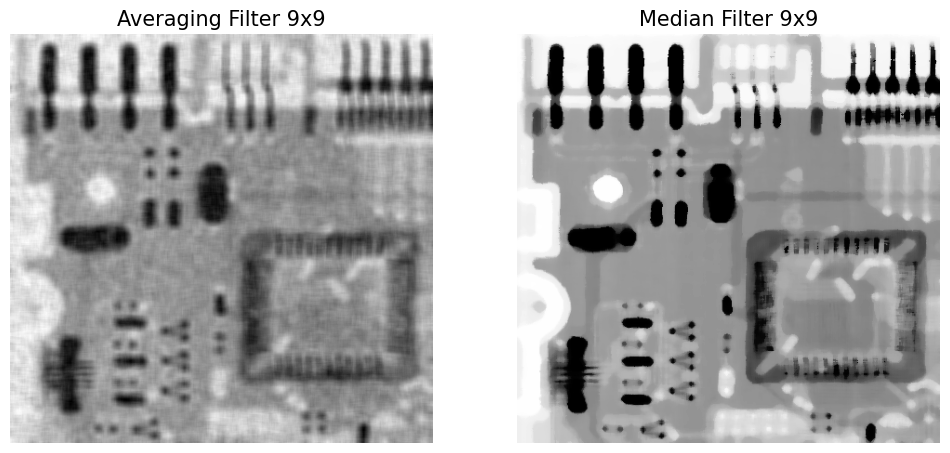

...

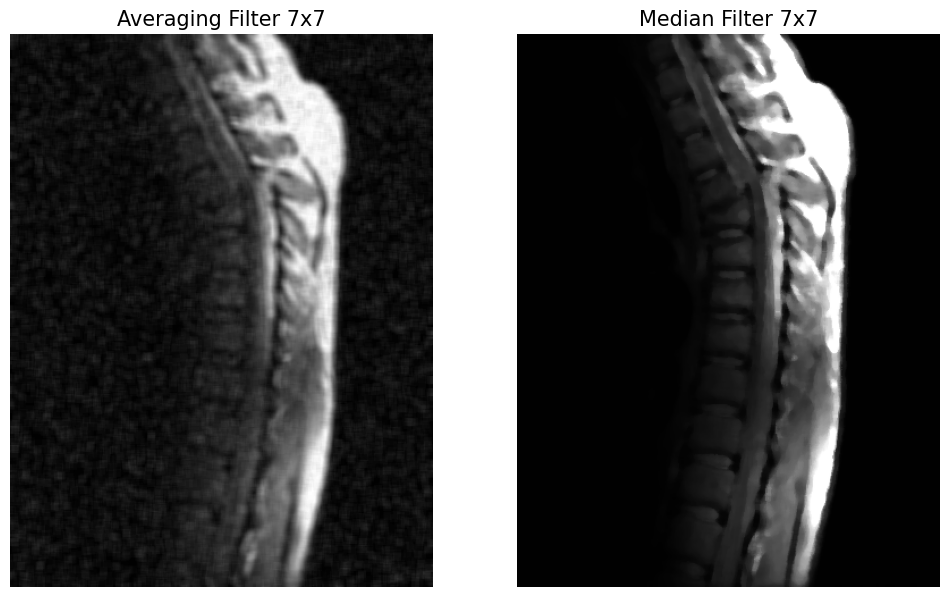

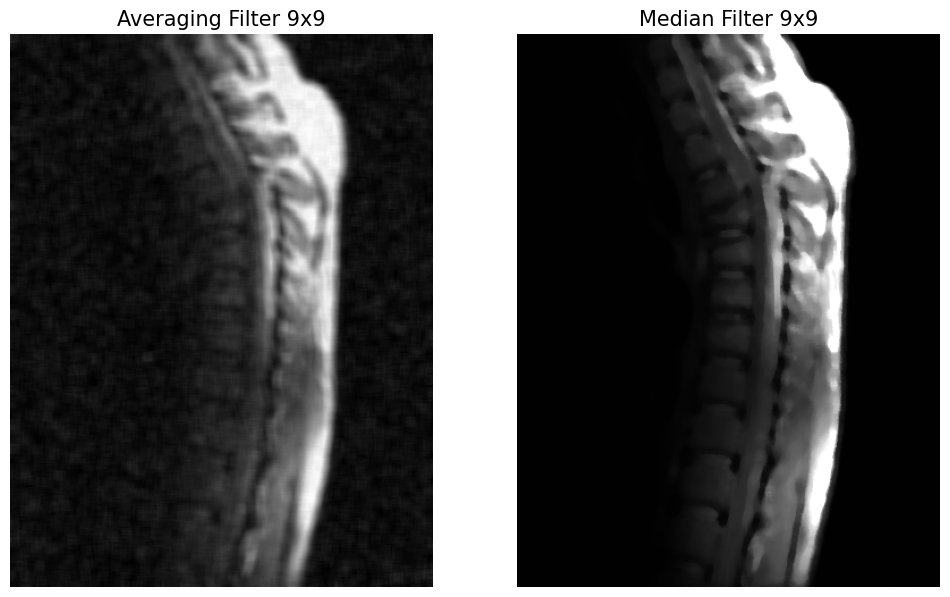

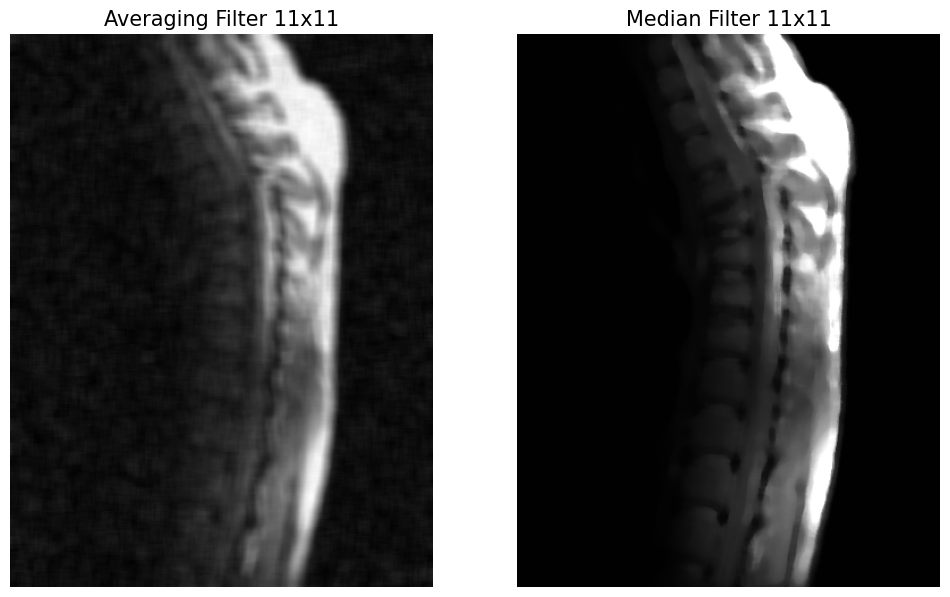

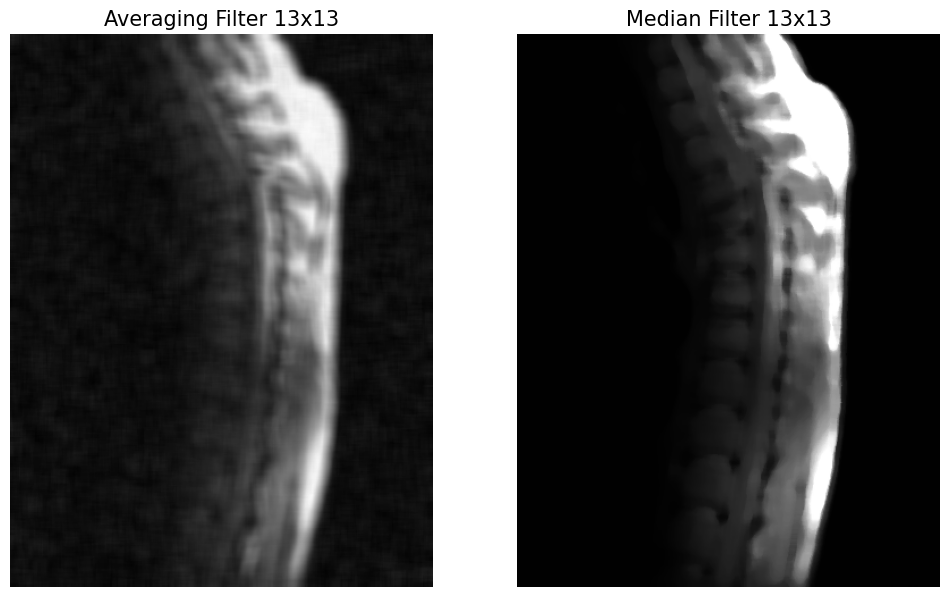

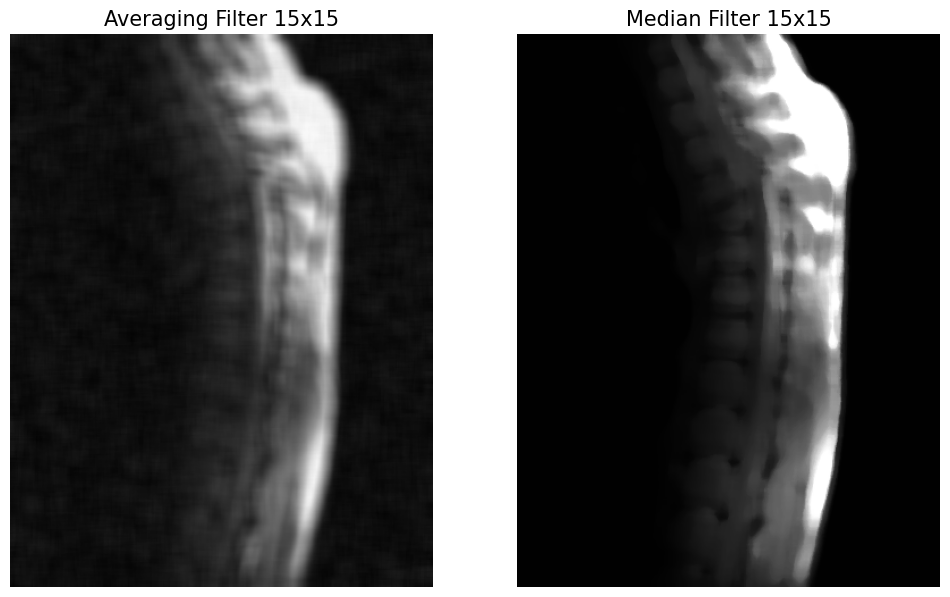

In [4]:
#Define function
def blurs(img):
    for i in range(3,17,2): #Varying the kernel size
        medianblur = cv2.medianBlur(img,i) #Applying median filter
        blur = cv2.blur(img,(i,i)) #Applying averaging filter
        plt.figure(figsize=(12,12)); plt.subplot(121); plt.imshow(blur, cmap='gray'); plt.title('Averaging Filter '+str(i)+"x"+str(i),fontsize="15");plt.axis('off')
        plt.subplot(122); plt.imshow(medianblur, cmap='gray'); plt.title('Median Filter '+str(i)+"x"+str(i),fontsize="15");plt.axis('off') #Plotting side to side

def sp_noise(image,per):

    output = np.zeros(image.shape,np.uint8) #Matrix of zeros with same size of input image
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            rdn = random.random() #Random float number ranging from 0 to 1
            if rdn < per:  
                output[i][j] = random.randint(0,255) #If the random number is less than the input percentage, give the pixel a random value
            else:
                output[i][j] = image[i][j] #If its not, give the pixel the original pixel value
    return output

image = cv2.imread("images/ckt_board_saltpep_prob_pt05.png", cv2.IMREAD_GRAYSCALE) #Reading the image
plt.figure(figsize=(6,6)); plt.imshow(image, cmap='gray'); plt.title('Original Image',fontsize="15");plt.axis('off') #Plotting the original image
blurs(image) #Calling the subroutine
newim = cv2.imread("images/blurry_moon.png", cv2.IMREAD_GRAYSCALE) #Reading another image
plt.figure(figsize=(12,12)); plt.subplot(1,2,1);plt.imshow(newim, cmap='gray'); plt.title('Original Image',fontsize="15");plt.axis('off') #Plotting noisy image
noise_img = sp_noise(newim,0.10) #Adding salt and pepper noise
plt.subplot(1,2,2); plt.imshow(noise_img, cmap='gray'); plt.title('Salt-Pepper corrupted Image',fontsize="15");plt.axis('off') #Plotting noisy image
blurs(noise_img) #Calling the subroutine
img1 = cv2.imread("images/"+imagesnames[11],1)
plt.figure(figsize=(12,12)); plt.subplot(1,2,1);plt.imshow(img1, cmap='gray'); plt.title('Original Image',fontsize="15");plt.axis('off') #Plotting noisy image
noise_img = sp_noise(img1,0.10) #Adding salt and pepper noise
plt.subplot(1,2,2); plt.imshow(noise_img, cmap='gray'); plt.title('Salt-Pepper corrupted Image',fontsize="15");plt.axis('off') #Plotting noisy image
blurs(noise_img) #Calling the subroutine
img2 = cv2.imread("images/"+imagesnames[15],1)
plt.figure(figsize=(12,12)); plt.subplot(1,2,1);plt.imshow(img2, cmap='gray'); plt.title('Original Image',fontsize="15");plt.axis('off') #Plotting noisy image
noise_img = sp_noise(img2,0.1) #Adding salt and pepper noise
plt.subplot(1,2,2); plt.imshow(noise_img, cmap='gray'); plt.title('Salt-Pepper corrupted Image',fontsize="15");plt.axis('off') #Plotting noisy image
blurs(noise_img) #Calling the subroutine


- Описание разработанной функции:

В этом пункте были разработаны одна подпрограмма и одна функция: Blurs() и Sp_noise() соответственно. Первая, Blurs(), представляет собой подпрограмму, которая получает массив изображений в качестве входного параметра и применяет к этому изображению как медианный фильтр, так и средний фильтр с размерами ядра 3x3, 5x5, 7x7, 9x9, 11x11, 13x13 и 15x15 во время построения графика. результаты рядом. Последняя, Sp_noise(), представляет собой функцию, которая получает в качестве входного параметра массив изображений и процентное значение. Функция возвращает исходное изображение, искаженное шумом соли и перца. Количество шума в изображении определяется входным процентом, числом от 0 до 1.

- Описание библиотечных функций, используемых в этом разделе:

Подпрограмма Blurs() применяет медиану и средний фильтр, используя функции medianBlur() и Blur() из библиотеки OpenCV. Обе функции получают исходное изображение и размер ядра для использования в качестве входных параметров, при этом размер является целым числом в функции medianBlur() и кортежем с шириной и высотой в функции Blur(), и обе они возвращают отфильтрованное изображение. Наконец, изображения строятся рядом друг с другом с помощью функции subplot() библиотеки Matplotlib. Этот процесс выполняется в цикле for, который проходит от 3 до 15 с шагом 2, определяющим размер ядра фильтров. Функция Sp_noise(), которая применяет шум соли и перца к входному массиву изображений, работает следующим образом: для каждого пикселя изображения генерируется случайное число в диапазоне от 0 до 1 с помощью функции random() библиотеки Random. Если это случайное число больше входного процента, который также является числом в диапазоне от 0 до 1, значение этого пикселя будет равно эквивалентному пикселю исходного изображения. В противном случае значение этого пикселя будет равно случайному целому числу в диапазоне от 0 до 255, сгенерированному с помощью функции randint() библиотеки Random. Эта функция получает верхнюю и нижнюю границы диапазона, из которого будет взято результирующее число.

-Анализ полученных результатов:

После применения медианного фильтра и усредняющего фильтра с размером ядра 3x3 к зашумленному изображению становится ясно, что медианный фильтр значительно лучше справляется с удалением шума из изображения. В то время как усредняющий фильтр просто размывает изображение, медианный фильтр почти полностью удаляет шум с практически незаметными искажениями.

Проблемы начинаются, когда увеличивается размер ядра. В случае с усредняющим фильтром размытие увеличивается до такой степени, что детали изображения практически невозможно заметить, а само изображение практически невозможно распознать. В случае медианного фильтра сначала шум еще больше снижается при незначительных искажениях изображения, хотя уменьшение шума гораздо менее заметно, чем увеличение искажения. При размерах ядра более 9х9 изображение воспринимается размытым, а при 15х15 мелкие детали полностью теряются.



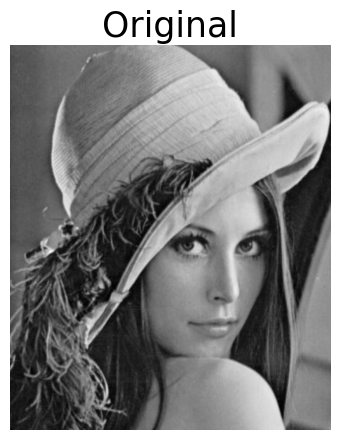

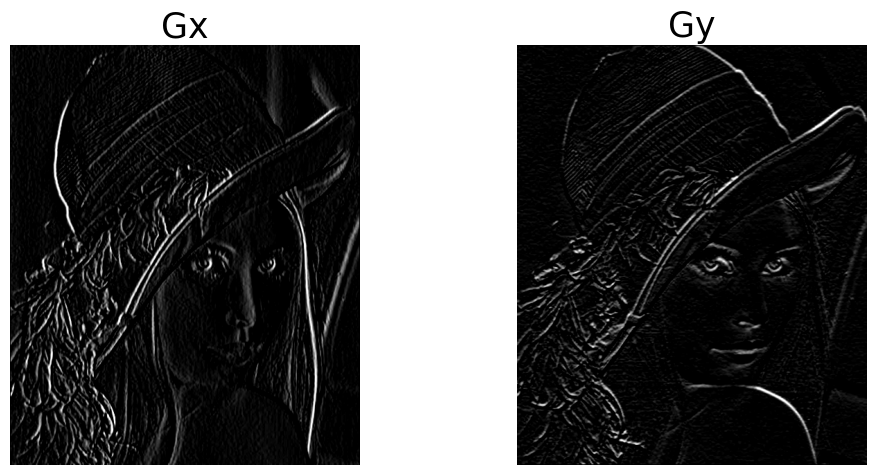

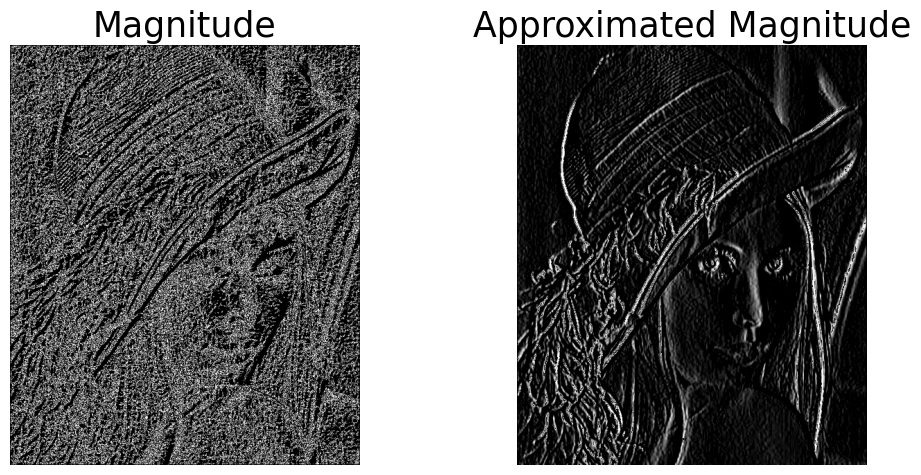

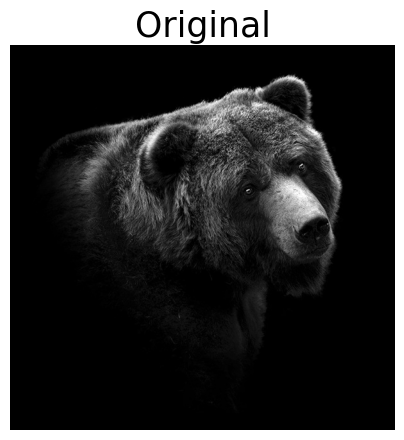

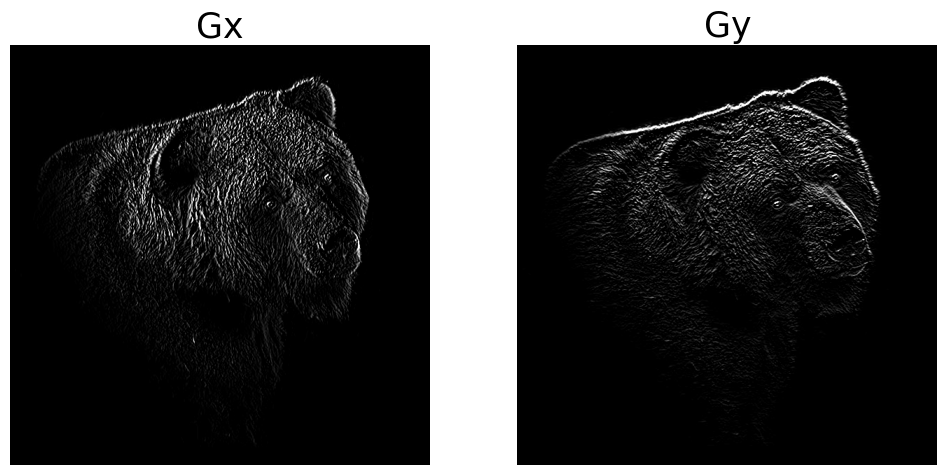

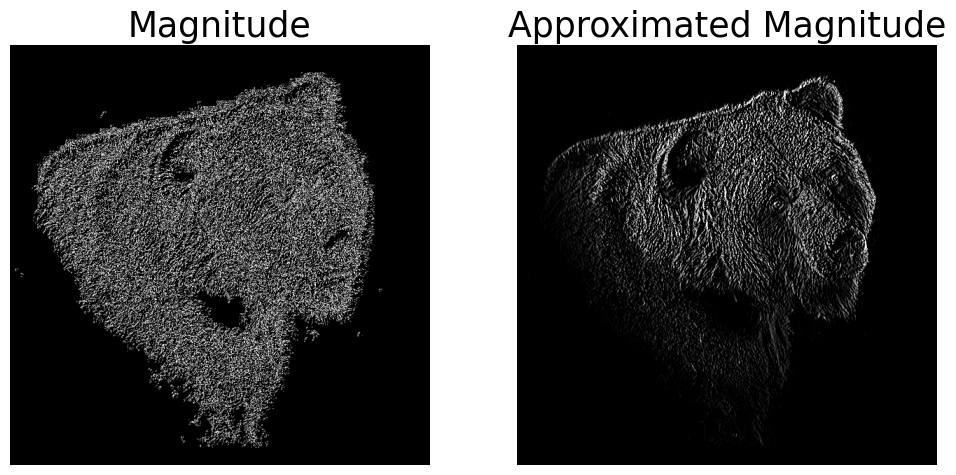

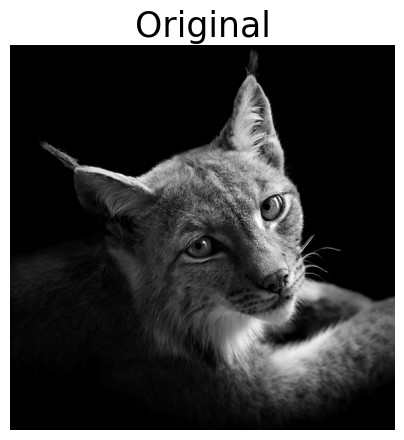

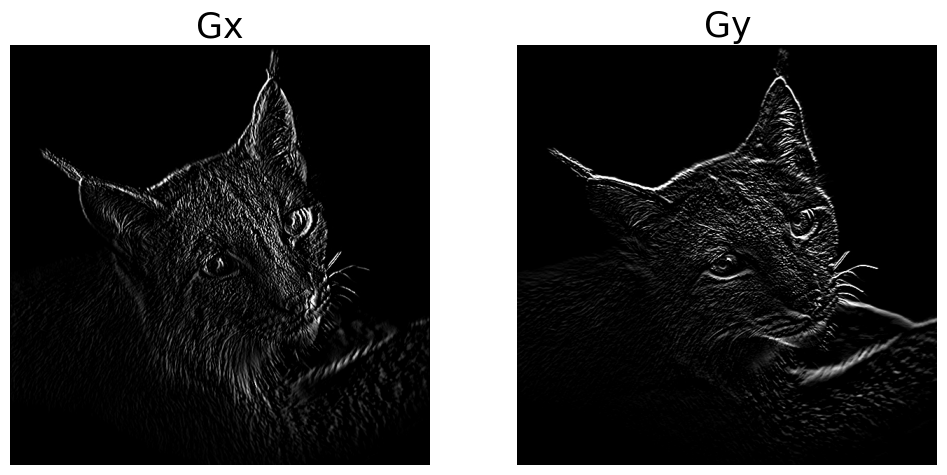

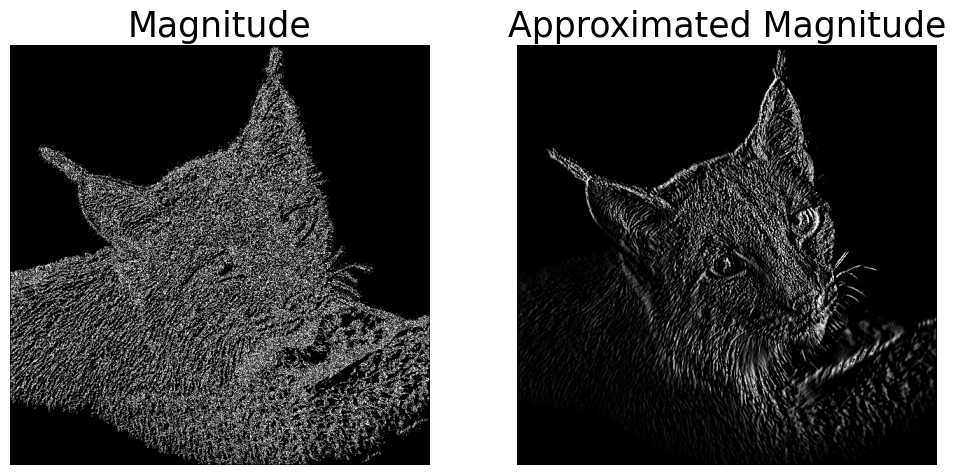

In [5]:
# Gradient

def calculate_image_gradient(img,kernel_Gx,kernel_Gy): #Function that calculates the image gradients in the x and y directions.
    Gx= cv2.filter2D(img,-1,kernel_Gx) #Convolve image with x-direction derivative kernel
    Gy= cv2.filter2D(img,-1,kernel_Gy) #Convolve image with y-direction derivative kernel
    return [Gx, Gy] #Return x and y direction derivatives


def compute_gradient_magnitude(Gx,Gy): #Function that computes the gradient magnitude of an image
    Gx= Gx**2  #Squaring x-direction derivative
    Gy= Gy**2  #Squaring y-direction derivative
    Gx_Gy=(Gx**2)+(Gy**2) 
    mag_gradient= Gx_Gy**(1/2) 
    return mag_gradient # Return gradient magnitude

def compute_aproximated_gradientmagnitude(Gx,Gy): #Function that computes an approximation of the gradient magnitude
    abs_Gx=cv2.convertScaleAbs(Gx) #X-Direction derivative magnitude
    abs_Gy=cv2.convertScaleAbs(Gy) #Y-Direction derivative magnitude
    mag_aprox=abs_Gx+abs_Gx #Sum of both derivatives magnitude 
    return mag_aprox  # Return approximated magnitude of gradient


img = cv2.imread ('images/lena.jpg',cv2.IMREAD_GRAYSCALE) #leer imagen
img2 =cv2.imread ('images/z6.jpg',cv2.IMREAD_GRAYSCALE) #leer imagen 
img3 =cv2.imread ('images/z7.jpg',cv2.IMREAD_GRAYSCALE) #leer imagen 
img_vector = [img,img2,img3]
img_names=[imagesnames[7],imagesnames[21],imagesnames[22]]
kernel_Gy = np.array([[-1,-2,-1],[0,0,0],[1,2,1]]) #Y-Direction derivative Kernel (Sobel Operator) 
kernel_Gx = np.array([[-1,0,1],[-2,0,2],[-1,0,1]]) #X-Direction derivative Kernel (Sobel Operator) 

for k in range(3):
    Gx,Gy = calculate_image_gradient(img_vector[k],kernel_Gx,kernel_Gy) #Call function calculate_image_gradient
    mag_gradient = compute_gradient_magnitude(Gx,Gy)  #Call function compute_gradient_magnitude
    mag_aprox1 = compute_aproximated_gradientmagnitude(Gx,Gy) #Call function compute_aproximated_gradientmagnitude
    plt.figure(figsize=(5,5)); plt.imshow(img_vector[k],cmap='gray');plt.title("Original",fontsize=25);plt.axis('off') #Display original image
    plt.figure(figsize=(12,12)); 
    plt.subplot(2,2,1);plt.imshow(Gx,cmap='gray');plt.title("Gx",fontsize=25);plt.axis('off')           #Display the image
    plt.subplot(2,2,2);plt.imshow(Gy,cmap='gray');plt.title("Gy",fontsize=25);plt.axis('off')           #Display the image
    plt.figure(figsize=(12,12)); 
    plt.subplot(2,2,1);plt.imshow(mag_gradient,cmap='gray');plt.title("Magnitude",fontsize=25);plt.axis('off')           #Display the image
    plt.subplot(2,2,2);plt.imshow(mag_aprox1,cmap='gray');plt.title("Approximated Magnitude",fontsize=25);plt.axis('off')           #Display the image

    plt.show()



- Описание разработанной функции:

Для разработки этого элемента необходимо было создать три функции. Первая функция получает три входных параметра: исходное изображение для обработки и ядра, которые необходимо применить для вычисления производных в направлениях x и y. В этом случае эти ядра соответствуют операторам Собеля, которые являются аппроксимацией оператора градиента. Эта функция возвращает производные по направлениям x и y. Вторая и третья функции получают производные по направлениям x и y (Gx и Gy) в качестве входных параметров и возвращают величину градиента и приблизительную величину градиента соответственно.

- Описание библиотечных функций, используемых в этом разделе:

Для разработки этого пункта снова использовались уже описанные функции библиотеки OPENCV. Кроме того, использовалась функция convertScaleAbs(), которая вычисляет абсолютное значение заданного массива и преобразует результат в 8-битный. Эта функция получает в качестве входного параметра массив, который в данном случае соответствует изображению.

-Анализ полученных результатов:

Градиенты изображения в направлениях x и y обычно используются для извлечения информации из изображения, поскольку они предоставляют информацию о направленном изменении интенсивности цвета изображения. Градиент равен нулю в областях с постоянной интенсивностью и пропорционален степени изменения интенсивности в областях, где значения интенсивности изменяются. Операторы градиента вычисляют аппроксимацию градиента функции интенсивности изображения, позволяя выделить горизонтальные и вертикальные изменения изображения. В частности, важно отметить, что вычисление градиента изображения в направлении x (применение первой производной по x) позволяет выделить вертикальные изменения в изображении, а с другой стороны, вычисление градиента изображения в направлении y позволяет выделить горизонтальные изменения. Кроме того, также важно отметить, что каждый оператор градиента выделяет области с высоким градиентом белым (эквивалентным границам), а остальные — черным (фон сгенерированного изображения).

Как видно из полученных результатов, величина градиента характеризует края изображения, поскольку градиенты изображения измеряют изменения значений интенсивности каждого пикселя изображения для обоих направлений x и y, и поэтому пиксели с большими значениями градиента становятся возможными краевые пиксели, что имеет смысл, учитывая, что яркость изображений резко меняется по краям. Наконец, важно отметить, что результаты, полученные по величине и аппроксимированной величине градиента, почти одинаковы, в обоих можно заметить горизонтальные и вертикальные изменения изображения.


In [7]:
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt
from os import listdir, path
%matplotlib inline

imagesnames = sorted(listdir('Original'))    
print(sorted(imagesnames))
print(len(imagesnames))


['Fig6.21(b).jpg', 'babypenguin.jpg', 'badexposure.jpg', 'badexposure2.jpg', 'badexposure3.jpg', 'basketballfield.jpg', 'blown_ic.png', 'blue.png', 'check.png', 'chest.jpg', 'cuadrado.png', 'dark_fountain.jpg', 'dinosaurio.jpg', 'doggy.jpg', 'equalized_fountain.jpg', 'face.png', 'flecha.jpg', 'flowers.jpg', 'fruits.jpg', 'hamster.jpg', 'hiro.jpg', 'landscapebad.jpg', 'lena.jpg', 'lion.jpg', 'messi.png', 'mountain.jpg', 'nebula.jpg', 'nebula2.jpg', 'new_chest.bmp', 'out.png', 'persona.jpg', 'persona2.jpg', 'persona3.jpg', 'punto.png', 'rectangle.png', 'rectangulo.png', 'rectangulo_rotado.png', 'squares.jpg', 'star_wars2.png', 'test_pattern_blurring_orig.png', 'translated_rectangle.png', 'weld_x-ray.jpg']
42


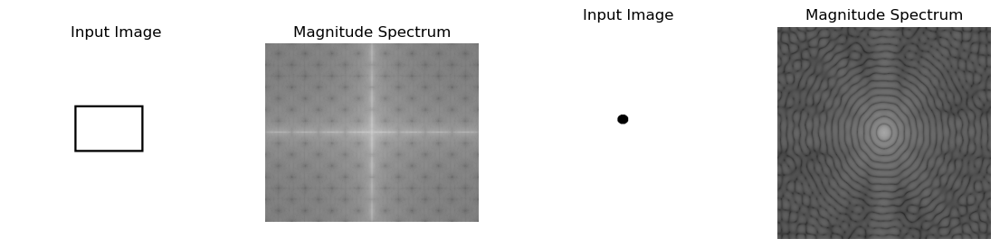

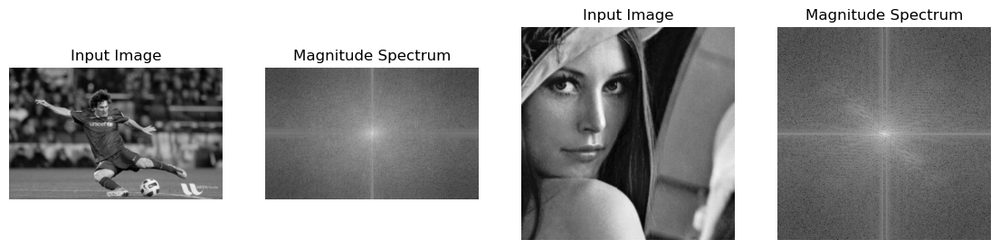

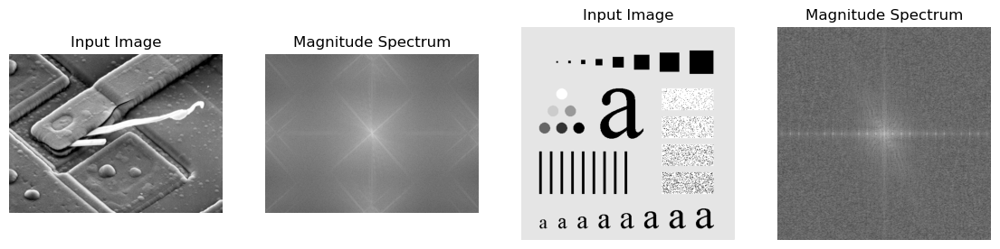

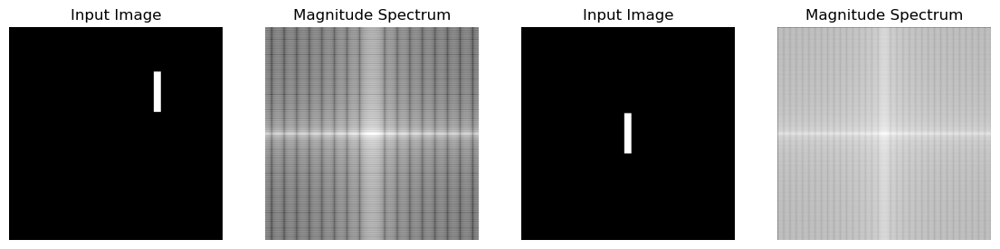

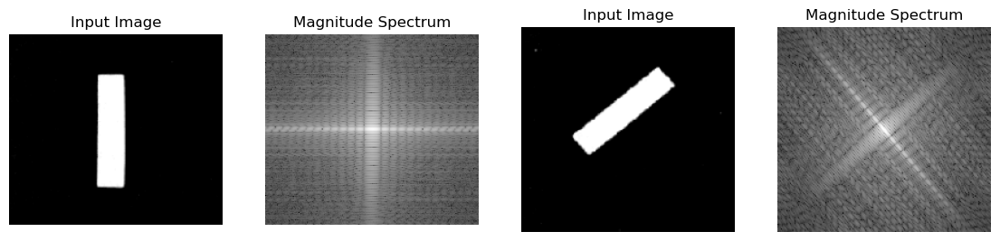

In [15]:
def fft(img):
    f = np.fft.fft2(img) #FFT of the input image
    f_c = np.fft.fftshift(f) #Center transformation
    height, width = f_c.shape[:2]  #Extract image size from shape function
    for i in range(height):       #Go over every row
            for j in range(width):    #Go over every column
                if np.any(f_c[i,j]==0): #Replace 0 with 10^-10
                    f_c[i,j]=10**-10
    magnitude_spectrum = 20*np.log(np.abs(f_c)) #Find the magnitude spectrum
    return magnitude_spectrum #Return spectrum

    
#Read images
img1 = cv2.imread ('Original/cuadrado.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image
img2 = cv2.imread ('Original/punto.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image
img3 = cv2.imread ('Original/messi.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image
img4 = cv2.imread ('Original/face.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image
img5 = cv2.imread ('Original/blown_ic.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image
img6 = cv2.imread ('Original/test_pattern_blurring_orig.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image
img7 = cv2.imread ('Original/translated_rectangle.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image
img8 = cv2.imread ('Original/rectangle.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image
img9 = cv2.imread ('Original/rectangulo.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image
img10 = cv2.imread ('Original/rectangulo_rotado.png',cv2.IMREAD_GRAYSCALE).astype("float32") #Load Image

#Compute FFT
magnitude_spectrum1=fft(img1) #Call function
magnitude_spectrum2=fft(img2) #Call function
magnitude_spectrum3=fft(img3) #Call function
magnitude_spectrum4=fft(img4) #Call function
magnitude_spectrum5=fft(img5) #Call function
magnitude_spectrum6=fft(img6) #Call function
magnitude_spectrum7=fft(img7) #Call function
magnitude_spectrum8=fft(img8) #Call function
magnitude_spectrum9=fft(img9) #Call function
magnitude_spectrum10=fft(img10) #Call function
#PLOT
vector_sources = [img1,magnitude_spectrum1,img2,magnitude_spectrum2,img3,magnitude_spectrum3,img4,magnitude_spectrum4,img5,magnitude_spectrum5,img6,magnitude_spectrum6,img7,magnitude_spectrum7,img8,magnitude_spectrum8,img9,magnitude_spectrum9,img10,magnitude_spectrum10]
vector_prop=[1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0,1,0]
cont = 0;
for i in range(int(len(vector_sources)/4)):
    plt.figure(figsize=(14,14));
    for k in range(4):
        plt.subplot(1,4,k+1);
        plt.imshow(vector_sources[cont],cmap = 'gray');plt.axis('off');
        if(vector_prop[cont]==1):
            plt.title('Input Image')
        else:
             plt.title('Magnitude Spectrum')
        cont += 1;
        

- Описание разработанной функции:

Разработанная в этом разделе функция fft получает в качестве параметра изображение, Фурье-спектр которого необходимо найти и отобразить. Эта функция возвращает спектр введенного изображения.

- Описание используемых библиотечных функций:

С целью разработки данного раздела использовалась библиотека OPENCV через которую выполнялись разные функции, первой была функция np.fft.fft2() которая вычисляет двумерное дискретное преобразование Фурье, эта функция имеет в качестве первого аргумента входное изображение в градациях серого, а второй аргумент является необязательным и определяет размер выходной матрицы. Если он больше, чем размер входного изображения, входное изображение дополняется нулями перед вычислением БПФ. Если оно меньше входного изображения, входное изображение будет обрезано. Если этот аргумент не указан, размер выходного массива будет таким же, как и входной. С полученным результатом можно заметить, что составляющая нулевой частоты (составляющая постоянного тока) находится в верхнем левом углу, поэтому желательно центрировать эту составляющую. Для этого нужно изменить результат на N/2 в обе стороны. Это делается с помощью второй функции, используемой np.fft.fftshift(), которая принимает расчет БПФ в качестве входного параметра. После этого вы можете найти амплитудный спектр. Для его нахождения использовались функции np.abs() и np.log(), вычисляющие абсолютное значение и натуральный логарифм соответственно.

Но имейте в виду, что если вы хотите найти логарифм числа, это не может быть ноль, так как этот логарифм не определен, тогда необходимо условие, что значение, равное 0, должно быть заменено очень маленьким числом, таким как 10 ^-10=0,0000000001. Для этого необходимо было найти размер изображения с помощью свойства «.shape», которое возвращает кортеж, состоящий из количества строк, столбцов и каналов изображения. Принимая во внимание, что желательны только высота и ширина каждого изображения, будут взяты первые два элемента кортежа (img.shape[:2]). Эти элементы хранятся в переменных высоты и ширины, которые будут пределами, до которых будут пройдены все столбцы и строки матрицы, чтобы заменить значения, равные нулю, в центрированной матрице БПФ введенного изображение.

Наконец, функция imread() библиотеки OPENCV используется для чтения изображения, к которому будет применена разработанная функция. Эта функция читает любое изображение и получает два параметра: путь, по которому находится изображение, и флаг, указывающий тип цвета загруженного изображения.

- Анализ результатов:

Изображение может быть представлено как сумма двух составляющих с разными пространственными масштабами: изображения с низкими частотами и изображения с высокими частотами. Преобразование Фурье предполагает, что одномерный сигнал может быть разложен на бесконечный набор сигналов синусоидального типа с разными частотами, амплитудами и фазами. Первая составляющая представляет собой среднюю амплитуду сигнала и имеет нулевую частоту, следующая составляющая имеет ту же частоту, что и исходный сигнал, а остальные составляющие постепенно приобретают более высокие частоты и называются гармониками.

В изображении в частотной области вы знаете, где находятся разные частотные диапазоны. Преобразование Фурье содержит комплексные числа, поэтому обычно анализируются его фазовая и спектральная составляющие. Каждая синусоидальная составляющая в изображении находится в фазе, а спектр представляет собой представление частот, составляющих сигнал, то есть, какая часть каждой синусоидальной составляющей присутствует в изображении. Спектр Фурье следует интерпретировать не как изображение, а как двумерное отображение мощности (или амплитуды) исходного изображения, это хорошо видно на первых двух изображениях. На других рисунках можно особым образом оценить представление частот, составляющих каждое изображение. Наконец, на последних четырех парах изображений виден эффект поворота, то есть если функцию F(x,y) повернуть на определенный угол, на преобразование также повлияет поворот на тот же угол.

(-0.5, 601.5, 417.5, -0.5)

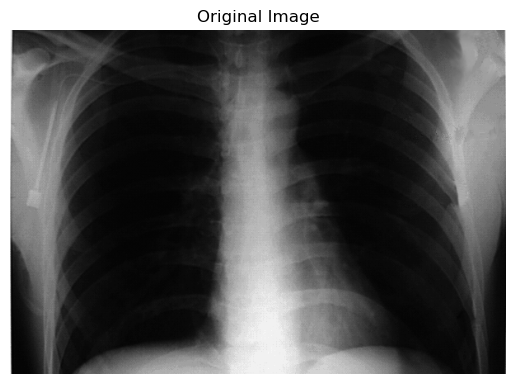

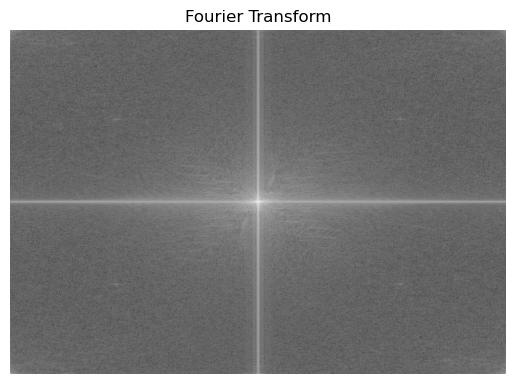

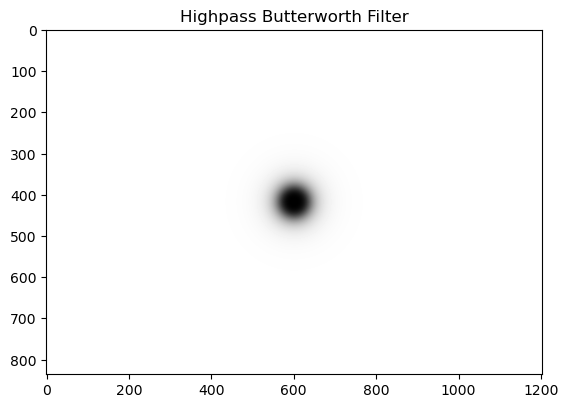

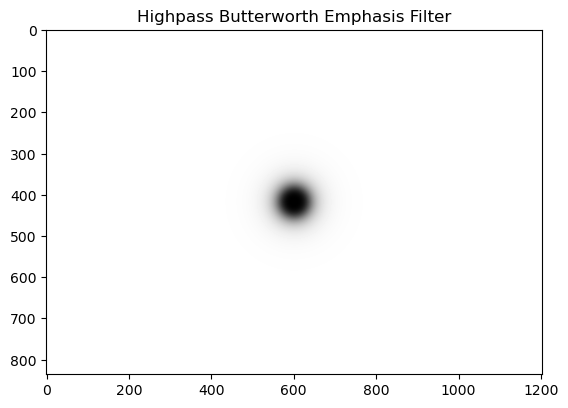

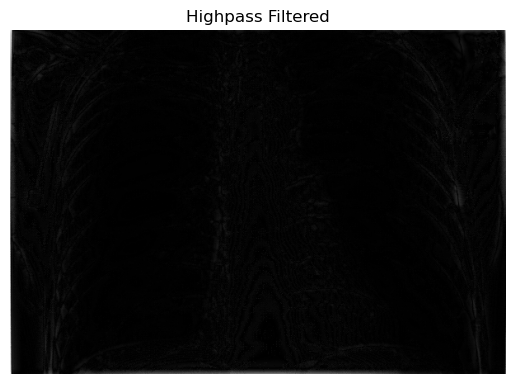

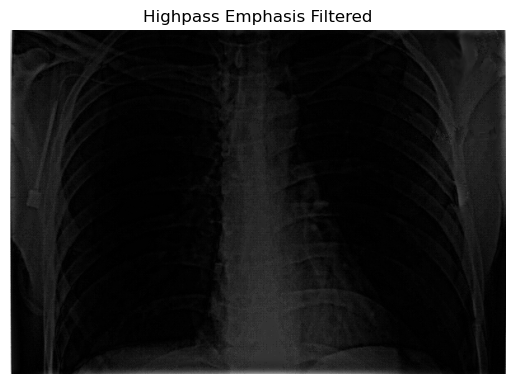

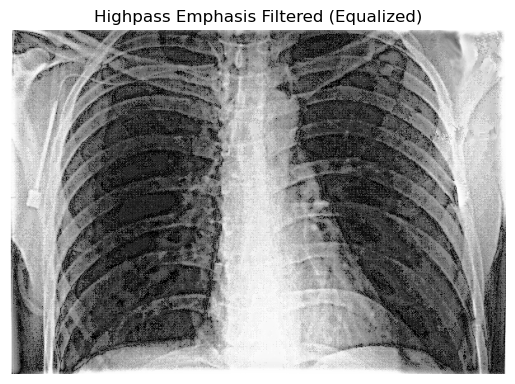

In [18]:
#Define function
def HFempFilter(image, vprct):
    #Convert the image to CV_32F to work with float values
    image = cv2.normalize(image, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    height = 2*np.size(image, 0) #Filter's height is twice the image height
    width = 2*np.size(image, 1) #Filter's width is twice the image width
    
    D0 = height*vprct #Cutoff frequency is equal to 0.05*(filter's height)
    #Center coordinates
    X2 = height/2
    Y2 = width/2
    
    transF = np.fft.fftshift(np.fft.fft2(image,[height,width])) #Shifted Fourier Transform with specified frequency domain dimensions
    #Plot the magnitude spectrum
    plt.figure(); plt.imshow(20*np.log(np.abs(transF)), cmap='gray'); plt.title("Fourier Transform");plt.axis('off')
    
    #Build the highpass Butterworth filter
    fil = np.zeros((height,width))
    
    for x in range(0,height):
        for y in range(0, width):
            dist = np.sqrt((x-X2)**2+(y-Y2)**2) #Euclidean distance
            if(dist!=0):
                fil.itemset((x,y), 1 / (1.0 + ( D0 / dist)**(2*2))) #Filter value
    
    #Plot the filters
    plt.figure(); plt.imshow(fil, cmap='gray'); plt.title("Highpass Butterworth Filter")
    plt.figure(); plt.imshow(0.5+2*fil, cmap='gray'); plt.title("Highpass Butterworth Emphasis Filter")
    
    #Apply highpass filter and highpass emphasis filter to the image
    multi1 = np.multiply(transF,fil)
    multi2 = np.multiply(transF,0.5+2*fil)
    
    #Return the image to spatial domain
    filteredA = np.abs(np.fft.ifft2(np.fft.ifftshift(multi1)))
    filteredB = np.abs(np.fft.ifft2(np.fft.ifftshift(multi2)))
    
    #Convert the images to CV_8U format for the equalizing function
    output_simple = cv2.normalize(filteredA[:np.size(image,0),:np.size(image,1)],None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    output_emp = cv2.normalize(filteredB[:np.size(image,0),:np.size(image,1)], None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    return [output_simple, output_emp]

imag = cv2.imread("Original/chest.jpg", cv2.IMREAD_GRAYSCALE)
#Plot the original image
plt.figure();plt.imshow(imag, cmap='gray'); plt.title("Original Image");plt.axis('off')
simple, emphasis = HFempFilter(imag, 0.05)
#Apply histogram equalization
emphasis_equ = cv2.equalizeHist(emphasis) 

#plot the results
plt.figure(); plt.imshow(simple, cmap='gray'); plt.title("Highpass Filtered");plt.axis('off')
plt.figure(); plt.imshow(emphasis, cmap='gray'); plt.title("Highpass Emphasis Filtered");plt.axis('off')
plt.figure(); plt.imshow(emphasis_equ, cmap='gray'); plt.title("Highpass Emphasis Filtered (Equalized)");plt.axis('off')


- Описание разработанной функции:

Разработанная в этом разделе функция HFempFilter() получает в качестве входных параметров изображение, к которому будет применен фильтр, и процентное значение, необходимое для расчета частоты среза. Функция возвращает два изображения, одно из которых представляет собой исходное изображение, просто отфильтрованное с помощью фильтра верхних частот, а другое — исходное изображение, отфильтрованное с помощью фильтра верхних частот с выделением. Однако функция также отображает во время своего выполнения амплитудный спектр входного изображения и двух используемых фильтров.

- Описание используемых библиотечных функций:

Для разработки этого раздела понадобились функции библиотеки Numpy, соответствующие преобразованию и обратному преобразованию Фурье в 2D, которые также использовались в предыдущем разделе. Однако в этом разделе требовалось, чтобы размер фильтра был в два раза больше размера входного изображения, поэтому при расчете преобразования Фурье входного изображения должны были быть указаны частотные размерности преобразования. Это достигается за счет использования второго аргумента функции Numpy fft.ifft2() , который указывает желаемые размеры для результирующего преобразования Фурье.

В дополнение к функциям Numpy, связанным с преобразованием Фурье, для разработки раздела были важны две функции OpenCV: normalize() и equalizeHist(). Первый, normalize(), был необходим для преобразования значений отфильтрованных изображений из диапазона значений [0,1] в диапазон значений [0,255]. Эта функция получает в качестве входных параметров изображение, которое необходимо нормализовать, нижние и верхние границы, а также тип данных, которые будет иметь полученное изображение. Для изображений, пиксели которых имеют целочисленные значения от 0 до 255, рекомендуемый тип данных — CV_8U. Для изображений, пиксели которых имеют значения с плавающей запятой от 0 до 1, рекомендуемый тип данных — CV_32F. Это важно, потому что следующая функция, equalizeHist(), получает входные данные только с типом данных CV_8U. Эта функция, как следует из ее названия, используется для применения к изображению выравнивания гистограммы.

- Анализ результатов:

При просмотре амплитудного спектра изображения сундука.jpg видно, что большая часть информации в этом изображении содержится в низких частотах. Это соответствует результату фильтрации изображения с помощью разработанного фильтра верхних частот: большая часть изображения ослабляется и затемняется, выделяя только силуэт позвоночника и наиболее заостренные части ребер. На отфильтрованном изображении с использованием ФВЧ с выделением больше акцентированы области ребер и позвоночника в целом. Один эффект, который сразу заметен, — резкое уменьшение яркого размытия, покрывающего различные области исходного изображения. Смягчение и дизеринг характерны для низких частот, поэтому неудивительно, что они значительно уменьшаются при применении фильтра верхних частот.

Наконец, при применении выравнивания гистограммы лучше визуализируются все детали изображения, которые даже в исходном изображении казались затененными, например ребра в середине изображения. Однако некоторые фигуры квадратной формы, которые были не очень заметны на исходном изображении, также подчеркнуты, последнее из-за эффектов применения эквалайзера.

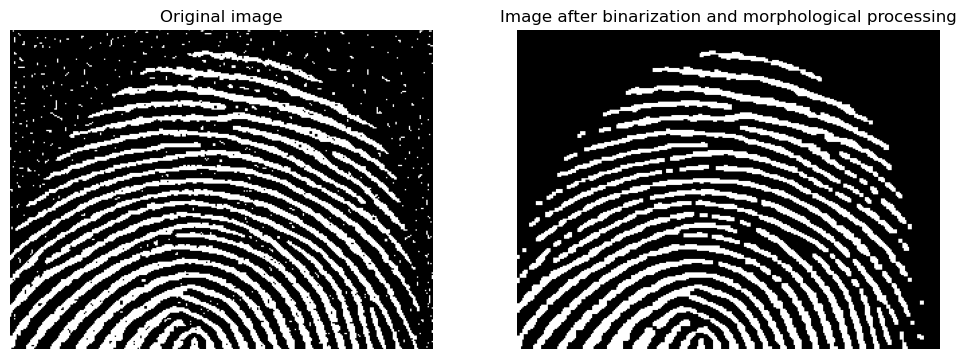

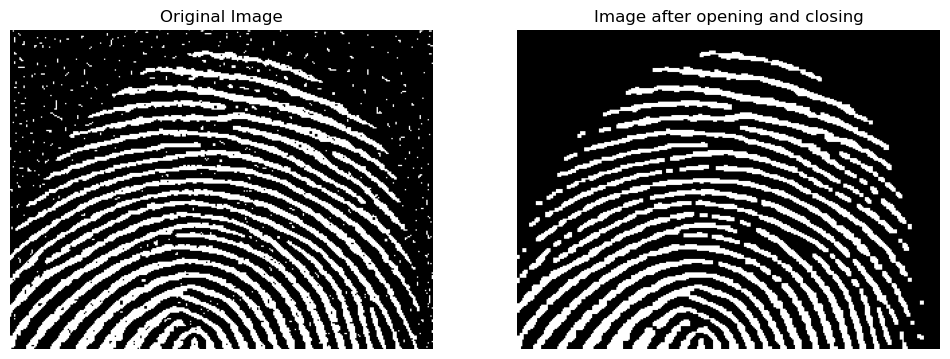

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from os import listdir, path
%matplotlib inline

def erode_dilate(img):
    kernel = np.ones((3,3),np.uint8) #Create a square-shaped structuring element of size 3 by 3
    paso1 = cv2.erode(img,kernel,iterations = 1) #Erode the input image
    paso2 = cv2.dilate(paso1,kernel,iterations = 1) #Dilate the result of paso1
    paso3 = cv2.dilate(paso2,kernel,iterations = 1) #Dilate the result of paso2
    paso4 = cv2.erode(paso3,kernel,iterations = 1)  #Erode the result of paso3
    return paso4
def opening_closing(img):
    kernel = np.ones((3,3),np.uint8) #Create a square-shaped structuring element of size 3 by 3
    opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel) #Perform opening of the input image
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel) # Compute the closing of the result of opening
    return closing
img = cv2.imread('Furia/noisy_fingerprint.jpg',0)  #Load Image
erodil= erode_dilate(img) #Call function ero_dil()
opclo=opening_closing(img) #Call function opening_closing()

plt.figure(figsize=(12,12));
plt.subplot(1,2,1); plt.imshow(img, cmap = 'gray');plt.title('Original image');plt.axis('off') #Display the image
plt.subplot(1,2,2); plt.imshow(erodil, cmap = 'gray');plt.title('Image after binarization and morphological processing');plt.axis('off') #Display the image
plt.figure(figsize=(12,12));
plt.subplot(1,2,1); plt.imshow(img, cmap = 'gray');plt.title('Original Image');plt.axis('off') #Display the image
plt.subplot(1,2,2); plt.imshow(opclo, cmap = 'gray');plt.title('Image after opening and closing');plt.axis('off') #Display the image
plt.show()



- Описание разработанной функции:

Для разработки этой задачи 1 были разработаны две функции. Первой функцией была erode_dilate(), которая получает в качестве параметра изображение, к которому будет применена первая последовательность морфологических операций, эрозия и дилатация, указанная в операторе подраздела, и возвращает изображение с примененными морфологическими операциями. Второй разработанной функцией была opens_closing(), которая получает в качестве параметра изображение, к которому должны быть применены операции открытия и закрытия, возвращая изображение, построенное после шагов, указанных в подразделе.

- Описание используемых библиотечных функций:

С целью разработки этого раздела использовалась библиотека OPENCV, через которую выполнялись разные функции, первой была функция one(). Эта функция получает желаемый размер и тип данных для матрицы, в этом случае матрица будет 3x3 и с 8-битными целыми данными без знака (uint8). Функция one() вернет новый массив заданного типа и формы, заполненный единицами. Затем использовались функции, выполняющие морфологическую операцию эрозии и дилатации, erode() и dilate() соответственно, которые получают в качестве параметров изображение, к которому будет применена морфологическая операция, элемент структурирования и количество итераций. После этого была использована функция nmorphologyEx(), которая позволяет применять к изображению другие морфологические операции, такие как открытие и закрытие. Эта функция получает в качестве параметров изображение, к которому будет применена морфологическая операция, тип морфологической операции, которая будет использоваться (в данном подразделе это будут cv2.MORPH_OPEN и cv2.MORPH_CLOSE) и структурирующий элемент или ядро.

Наконец, используется функция imread(), которая считывает любое изображение и получает два параметра: путь, по которому находится изображение, и индикатор, указывающий тип цвета загруженного изображения. Функция imshow() также использовалась для отображения исходных и результирующих изображений последовательностей.

- Анализ результатов:

Морфологические операции упрощают изображения и сохраняют основные характеристики формы объектов. Эрозию обычно понимают как уменьшение исходного изображения, а дилатацию — как расширение изображения. Можно сказать, что дилатация и эрозия очень похожи в том смысле, что один выполняет морфологическую операцию над объектом, другой — над фоном изображения. Эти морфологические операции можно применять к изображению независимо друг от друга, но их также можно комбинировать для достижения лучших результатов. Эти комбинации открываются и закрываются, сначала происходит расширение изображения, а затем его размывание, наоборот, смыкание дает размывание расширенного изображения.

Основываясь на том, что было разработано в этом разделе, можно было определить, что применение первой последовательности к изображению (эрозия-расширение-дилатация-эрозия) дает тот же результат при применении второй последовательности открытия-закрытия (расширение-эрозия-эрозия-эрозия). расширение), поскольку к изображению применяются одни и те же морфологические операции, но с двумя разными последовательностями.

(-0.5, 499.5, 499.5, -0.5)

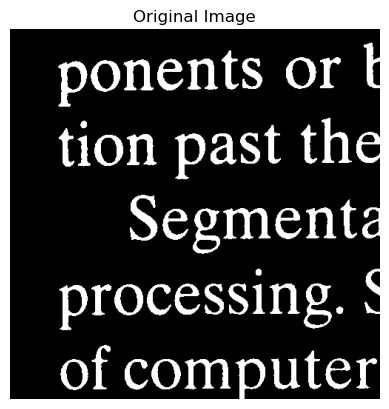

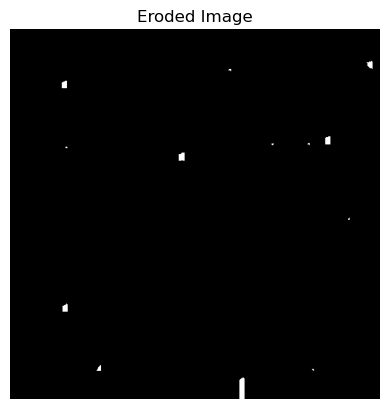

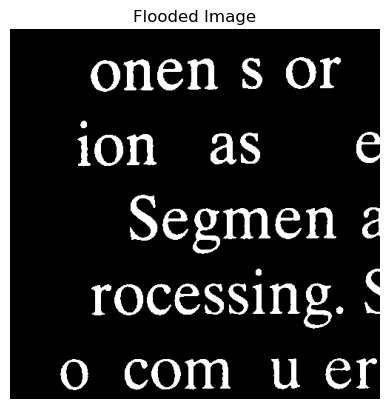

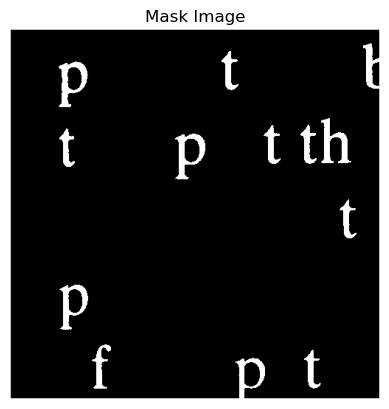

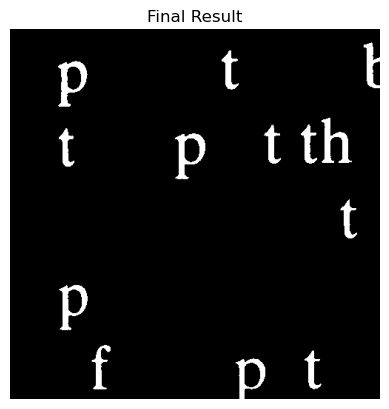

In [22]:
def replication(image):
    kernel = np.ones((51,1), np.uint8) 
    erosion = cv2.erode(image, kernel) 
    plt.figure(); plt.imshow(erosion, cmap='gray'); plt.title("Eroded Image");plt.axis('off') 
    h, w = image.shape 
    image2 = image.copy() 
    mask = np.zeros((h+2, w+2), np.uint8) 
    for i in range(h):
        for j in range(w):
            if(erosion[i,j] > 0.5): 
                cv2.floodFill(image2, mask,(j,i), 0) 
    image = image - image2 
    return image2, mask, image

imag = cv2.imread("Furia/steve_blog.png", cv2.IMREAD_GRAYSCALE)
plt.figure(); plt.imshow(imag, cmap='gray'); plt.title("Original Image");plt.axis('off')
imag2, mask, final = replication(imag)
plt.figure(); plt.imshow(imag2, cmap='gray'); plt.title("Flooded Image");plt.axis('off')
plt.figure(); plt.imshow(mask, cmap='gray'); plt.title("Mask Image");plt.axis('off')
plt.figure(); plt.imshow(final, cmap='gray'); plt.title("Final Result");plt.axis('off')


- Описание разработанной функции:

Разработанная в этом разделе функция replicate() получает в качестве входного параметра изображение и реплицирует результат, упомянутый в статье Стива Эддинса, сделанный в MATLAB, идентифицирует символы с вытянутым вертикальным сегментом и удаляет остальные в изображении.

- Описание используемых библиотечных функций:

Для выполнения этого раздела использовалась функция erode() библиотеки OpenCV, которая получает в качестве входных параметров изображение, к которому требуется применить эрозию, и элемент структурирования, по которому будет выполняться эрозия. В данном случае структурирующий элемент равен матрице из единиц размером 51x1, как описано в статье Стива Эддинса. Результатом эрозии является изображение, на котором остаются только остатки букв, соответствующих заданному условию.

Что было сделано для восстановления букв из размытого изображения, так это использование функцииfloodfill() из библиотеки OpenCV аналогично тому, как она использовалась в предыдущем разделе. Были пройдены все пиксели эродированного изображения и примененаfloodfill() в точке, где был обнаружен белый пиксель, хотя в данном случае цвет был фиксированным: черный. В этом подразделе важна маска, используемая в функцииfloodfill(). Это, как и в предыдущей части, матрица нулей. Однако всякий раз, когда компонент помечается с помощью функцииfloodfill(), этот же компонент помечается в оболочке белым цветом. То есть каждый раз, когда на изображении «стирается» буква, эта же буква отмечается в маске, так что, когда процесс маркировки всех букв черным цветом завершится, маска будет содержать все интересующие символы.

Однако некоторые буквы имеют небольшие искажения, поэтому лучший результат достигается при использовании изображения со «стертыми» буквами. Поскольку это изображение и оригинал отличаются только отсутствием некоторых символов в одном, можно просто вычесть изображение без некоторых символов из исходного изображения, в результате чего получится изображение, содержащее все нужные символы без искажений.

Tested conditions: Kernel Sizes = [1x1,5x5,9x9]  minVal=[0,50,100] maxVal=[20,100,200]


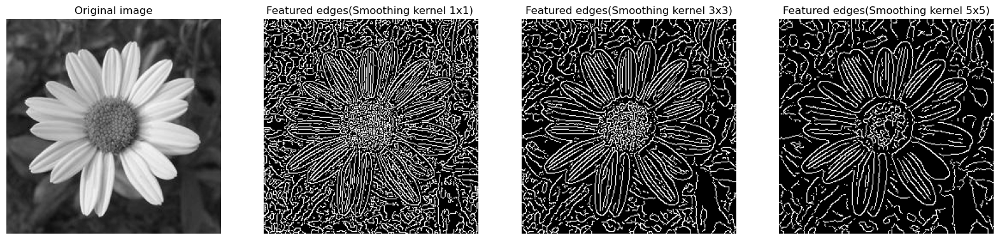

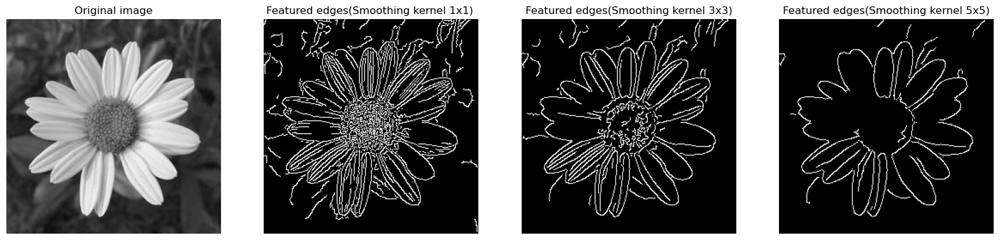

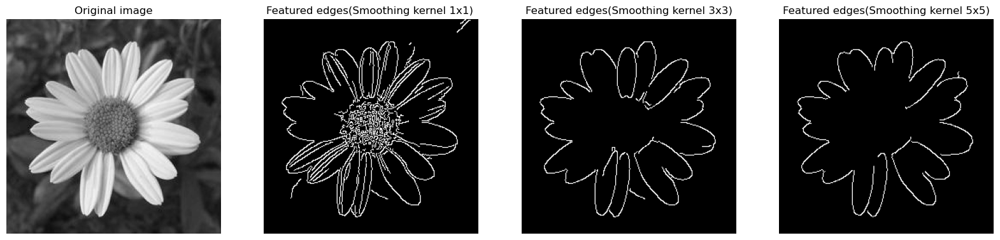

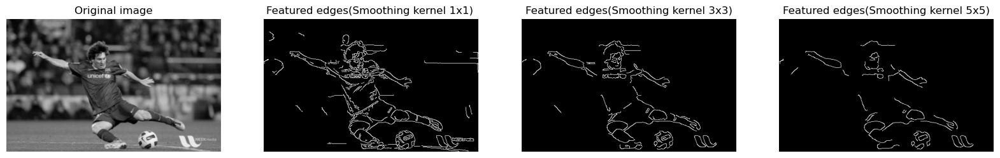

In [21]:
def canny(img,sizes_kernel,minVal,maxVal):
    gblu=cv2.GaussianBlur(img,(sizes_kernel,sizes_kernel),0) #Smooth the image with Guassian filter
    canny= cv2.Canny(gblu,minVal,maxVal) #Detects edges using Canny’s method
    return canny #Return edges of the image
images_names=['Furia/flower.jpg','Furia/messi.PNG']
sizes =[1,5,9]
minval = [0,50,100]
maxval = [20,100,200]
cannyv = []
print("Tested conditions: Kernel Sizes = [1x1,5x5,9x9]  minVal=[0,50,100] maxVal=[20,100,200]")
for i in range(len(images_names)):
    img = cv2.imread(images_names[i],0)
    for j in range(len(maxval)):
        if(i==0 or (i==1 and j>1)):
            canny1 = canny(img,sizes[0],minval[j],maxval[j])
            canny2 = canny(img,sizes[1],minval[j],maxval[j])
            canny3 = canny(img,sizes[2],minval[j],maxval[j])
            plt.figure(figsize=(20,20));
            plt.subplot(1,4,1); plt.imshow(img, cmap = 'gray');plt.title('Original image');plt.axis('off') #Display the image
            plt.subplot(1,4,2); plt.imshow(canny1, cmap = 'gray');plt.title('Featured edges(Smoothing kernel 1x1) ');plt.axis('off') #Display the image
            plt.subplot(1,4,3); plt.imshow(canny2, cmap = 'gray');plt.title('Featured edges(Smoothing kernel 3x3)');plt.axis('off') #Display the image
            plt.subplot(1,4,4); plt.imshow(canny3, cmap = 'gray');plt.title('Featured edges(Smoothing kernel 5x5)');plt.axis('off') #Display the image


    


- Описание разработанной функции:

Для этой части была разработана функция canny(), позволяющая сгладить изображение с помощью фильтра Гаусса, а затем обнаружить края сглаженного изображения с помощью метода Кэнни. Эта функция получает три входных параметра: изображение для работы, размер ядра для фильтра Гаусса, минимальное и максимальное пороговое значение. И возвращает изображение с границами входного изображения.

- Описание используемых библиотечных функций:

Для разработки этого раздела было использовано несколько функций, одна из которых — GaussianBlur(), которая сглаживает изображение путем его свертки с ядром фильтра нижних частот. Эта функция получает в качестве параметров сглаживаемое изображение, ширину и высоту ядра и стандартное отклонение в направлениях X и Y. Другой функцией была Canny(), используемая для применения метода Canny, она получает изображение в качестве параметров, в в этом случае будет сглаженное изображение, минимальное и максимальное пороговое значение. Также используется функция imread(), которая считывает любое изображение и получает два параметра: путь, по которому находится изображение, и индикатор, указывающий тип цвета загруженного изображения. Наконец, функция imshow() используется для отображения исходного изображения и изображений с обнаруженными границами.

- Анализ результатов:

Детектор краев Канни — это оператор обнаружения краев, использующий многоэтапный алгоритм для обнаружения широкого диапазона краев на изображениях.Для этого оператора необходимо учитывать минимальное значение и максимальное пороговое значение, поскольку с их помощью решается, какое из всех ребер действительно являются ребрами, а какие нет. Этот выбор краев выполняется следующим образом: все края с градиентом интенсивности выше максимального порогового значения обязательно будут краями объекта, поэтому они будут выделены, а те, которые ниже минимального порогового значения, обязательно не будут выделены. края. Значения, которые попадают между этими двумя пороговыми значениями, классифицируются как ребра или не ребра на основе их связности, то есть, если они связаны с «безопасными» пикселями в качестве ребер, они считаются частью ребер, в противном случае они не отбрасываются или отбрасываются, они помечаются как неребра.

Кроме того, важно подчеркнуть, что сглаживание изображения полезно для удаления шума. Он удаляет высокочастотный контент из изображения, поэтому при этой операции края немного размываются. По этой причине важно адекватно задать размер ядра для фильтра Гаусса, так как в зависимости от него могут быть исключены или не исключены ребра, позволяющие адекватно идентифицировать объект исследования.

Исходя из того, что было разработано в этом разделе, видно, что имея ошибочные значения минимального и максимального порога, невозможно обнаружить не только края, необходимые для выделения объекта, но и любой край фона изображения выделен, как это наблюдается в двух первых рядах изображений, но с соответствующими минимальными и максимальными пороговыми значениями оцениваются только края фигуры, которые необходимо отметить (см. третий ряд изображений). В дополнение к пороговым значениям следует отметить, что выбор размера ядра для сглаживающего фильтра важен, поскольку, если он слишком велик, будет отфильтровано много краев, и, несмотря на соответствующие пороговые значения, фигура не будет отображаться должным образом. наблюдается, потому что большая часть краев была стерта при сглаживании изображения.

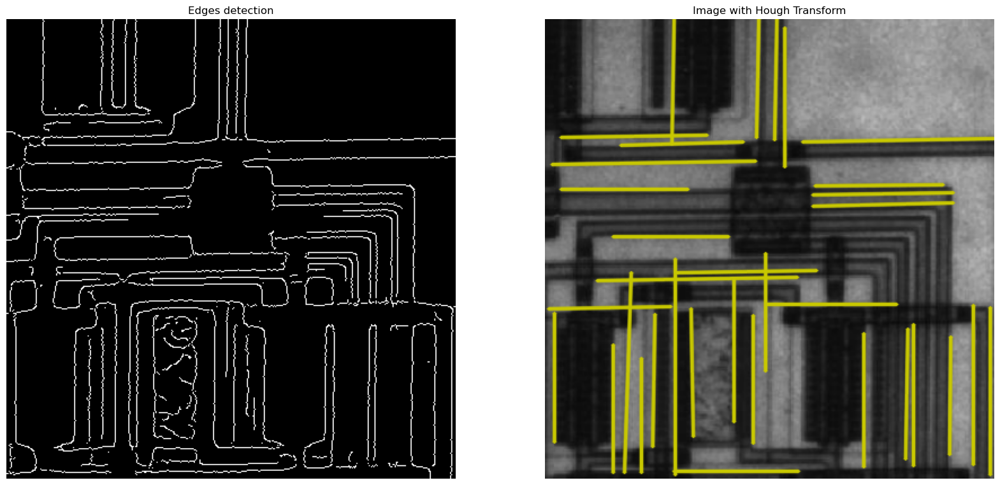

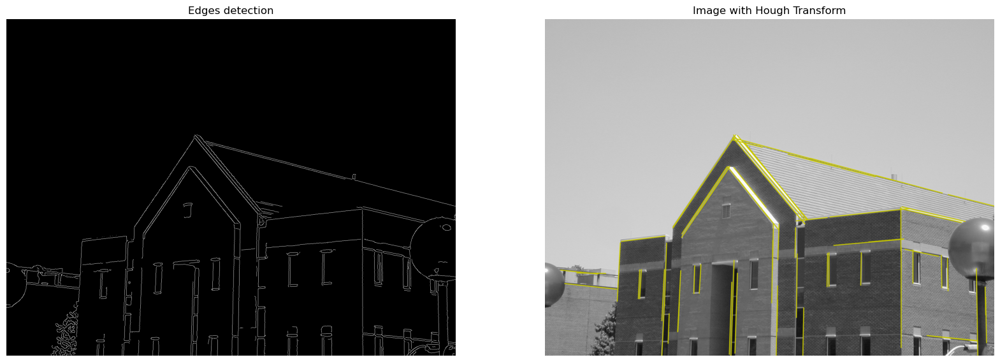

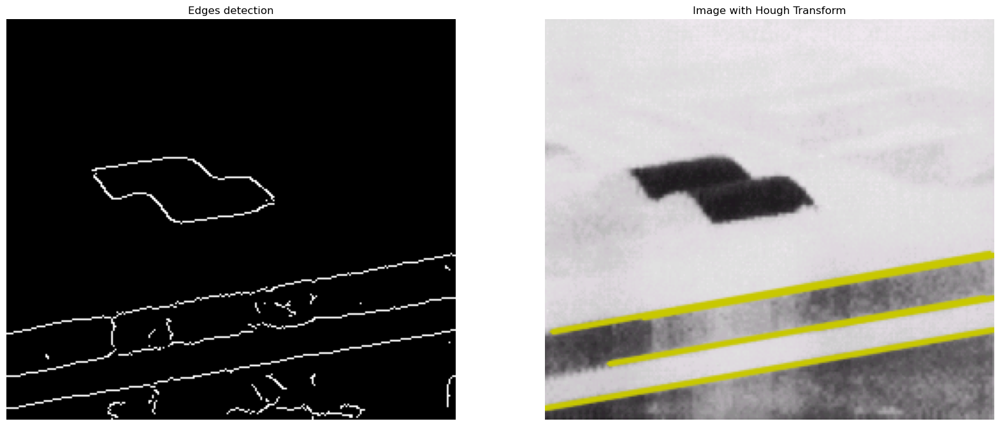

In [23]:
def Hough_Transform(img):
    gblu=cv2.GaussianBlur(img,(15,15),2.6) #Smooth the image with Guassian filter
    edges = cv2.Canny(gblu,20,40) #Detects edges using Canny’s method
    minLineLength=100
    lines = cv2.HoughLinesP(image=edges,rho=1.6,theta=np.pi/180,threshold=90,minLineLength=100,maxLineGap=20)
    if((cv2.__version__)[0]=='2'):
        for x1,y1,x2,y2 in lines[0]:
            cv2.line(img,(x1,y1),(x2,y2),(200,200,0),2,cv2.CV_AA)
    else:
        a,b,c = lines.shape 
        for i in range(a):
            cv2.line(img, (lines[i][0][0], lines[i][0][1]), (lines[i][0][2], lines[i][0][3]), (200, 200, 0), 2, cv2.LINE_AA)# Draw lines
    return edges,img

image= cv2.imread('Furia/canny_img.PNG')#Load Image
image_copy= image.copy()
img_edges,img_ht=Hough_Transform(image_copy)#Call function
image1= cv2.imread('Furia/building.jpg')#Load Image
image_copy1= image1.copy()
img_edges1,img_ht1=Hough_Transform(image_copy1)#Call function
image2= cv2.imread('Furia/prueba.PNG')#Load Image
image_copy2= image2.copy()
img_edges2,img_ht2=Hough_Transform(image_copy2)#Call functio
        
plt.figure(figsize=(20,20));
plt.subplot(1,2,1); plt.imshow(img_edges, cmap = 'gray');plt.title('Edges detection');plt.axis('off') #Display the image
plt.subplot(1,2,2); plt.imshow(img_ht, cmap = 'gray');plt.title('Image with Hough Transform');plt.axis('off') #Display the image
plt.figure(figsize=(20,20));
plt.subplot(1,2,1); plt.imshow(img_edges1, cmap = 'gray');plt.title('Edges detection');plt.axis('off') #Display the image
plt.subplot(1,2,2); plt.imshow(img_ht1, cmap = 'gray');plt.title('Image with Hough Transform');plt.axis('off') #Display the image
plt.figure(figsize=(20,20));
plt.subplot(1,2,1); plt.imshow(img_edges2, cmap = 'gray');plt.title('Edges detection');plt.axis('off') #Display the image
plt.subplot(1,2,2); plt.imshow(img_ht2, cmap = 'gray');plt.title('Image with Hough Transform');plt.axis('off') #Display the image
plt.show()


     

- Описание разработанной функции:

Была разработана функция Hough_Transform(), которая позволяет обнаруживать линии с помощью преобразования Хафа.Эта функция получает изображение в градациях серого в качестве параметра и возвращает линии, обнаруженные в верхней части входного изображения.

- Описание используемых библиотечных функций:

Для разработки этого раздела было использовано несколько функций. Одной из таких функций была GaussianBlur(), описанная в предыдущем разделе для сглаживания изображения перед обнаружением его краев. Функция Canny() также использовалась для обнаружения краев изображения с использованием метода Кэнни. Необходимо было использовать функцию HoughLinesP(), которая находит отрезки прямых в бинарном изображении с помощью вероятностного преобразования Хафа. Эта функция получает несколько параметров: изображение, с которым она будет работать, в данном случае это будет изображение с обнаруженными краями, выходной вектор линий, разрешение накопителя по расстоянию в пикселях (Rho), угол разрешения накопитель в радианах (тета), пороговое значение, минимальная длина линии (сегменты линии короче, чем те, которые были отклонены) и максимально допустимый интервал между точками на одной линии, чтобы связать их. Также использовалась функция line(), которая рисует отрезок, соединяющий две точки, для этого ей нужны следующие параметры: изображение, первая точка отрезка, вторая точка отрезка, цвет линии, толщина линии , тип линии (в данном случае антисоюзная линия)

Наконец, используется функция imread(), которая считывает любое изображение и получает два параметра: путь, по которому находится изображение, и индикатор, указывающий тип цвета загруженного изображения. Функция imshow() также использовалась для отображения изображений.

- Анализ результатов:

При разработке этого раздела можно было проверить результаты предыдущего раздела, то есть выделить соответствующие края изображения, размер ядра для сглаживания изображения, а также максимальное и минимальное пороговое значение, которое необходимо применить. Аккаунт Хитрый метод. С другой стороны, подчеркивается, что нахождение отрезков линии в бинарном изображении с использованием вероятностного преобразования Хафа зависит от значения ро, тета и максимального интервала, разрешенного на одной линии для соединения точек. Это видно на показанных изображениях, на трех изображениях были обработаны одни и те же параметры и, несмотря на это, на первом изображении выделяются только некоторые линии, на других изображениях, наоборот, можно выделить все линии, которые вы хотите чтобы выделить изображение, имея соответствующие параметры. В заключение, параметры для использования преобразования Хафа будут зависеть от каждого изображения.

The initial value of Threshold in Fig.1 is: 126.5
The new Threshold value in Fig.1 is: 57.91987760416667


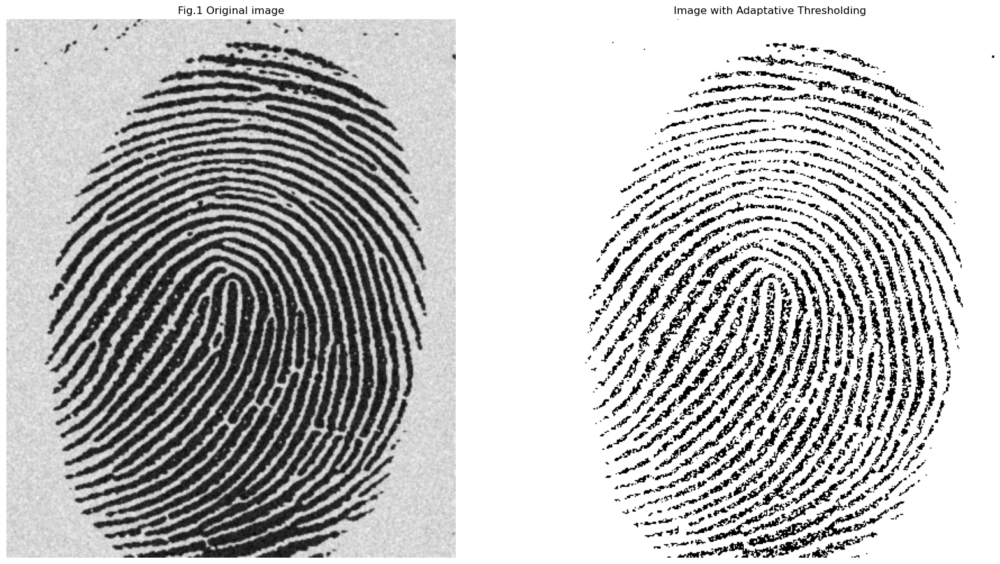

In [25]:
def Adaptative_Thresholding(img, T0):
    _, th = cv2.threshold(img, T0, 255, cv2.THRESH_BINARY) #Binarized image at the inicial threshold value
    g1_u1 = np.mean(th*img) #Compute the intensity averages μ1
    g2_u2 = np.mean(cv2.bitwise_not(th)*img) #Compute the intensity averages μ2
    NT = (g1_u1 + g2_u2)/2 #Compute a new threshold value
    if np.abs(NT - T0) > 1e-13: #Difference in  T  between successive iterations
        return Adaptative_Thresholding(img, NT) #Repeat steps 2-4
    else:
        _, thNew = cv2.threshold(img, NT, 255, cv2.THRESH_BINARY) #Binarized image at the new threshold value
        return thNew,NT #Return binarized image with the new threshold value and new threshold value 

image = cv2.imread('Furia/fingerprint.jpg',0)#Load Image
ti = (np.max(image)+np.min(image))/2 # Initial threshold value
print('The initial value of Threshold in Fig.1 is:',ti)
bimg,newT = Adaptative_Thresholding(image, ti) #Call function
print('The new Threshold value in Fig.1 is:',newT)


plt.figure(figsize=(20,20));
plt.subplot(1,2,1); plt.imshow(image, cmap = 'gray');plt.title('Fig.1 Original image');plt.axis('off') #Display the image
plt.subplot(1,2,2); plt.imshow(bimg, cmap = 'gray');plt.title('Image with Adaptative Thresholding');plt.axis('off') #Display the image
plt.show()
    


     

- Описание разработанной функции:

Для этого подраздела была разработана функция Adaptative_Thresholding(), позволяющая реализовать алгоритм адаптивного порога, описанный в подразделе. Эта функция принимает в качестве входных параметров изображение и начальное пороговое значение, которое ищется по среднему значению максимального и минимального значений интенсивности изображения. В результате эта функция возвращает бинарное изображение с новым пороговым значением и этим новым пороговым значением.

- Описание используемых библиотечных функций:

Для разработки задачи 7 использовались следующие функции:
threshold(): эта функция применяет порог фиксированного уровня к каждому элементу массива, принимая в качестве входных параметров изображение, значение порога, максимальное значение порога и тип порога (в данном случае это будет THRESH_BINARY). Y возвращает вычисленное пороговое значение.
mean(): позволяет вычислить среднее (среднее) элементов массива, который он получает в качестве входного параметра.
abs(): вычисляет абсолютное значение каждого элемента массива. Получает выражение в качестве входного параметра и возвращает абсолютное значение этого выражения.
max(): эта функция вычисляет максимум массива. Он получает в качестве входного параметра массив и возвращает его максимальное значение.
min(): вычисляет минимум массива. Он получает в качестве входного параметра массив и возвращает его минимальное значение.
Наконец, были использованы функция imread() и функция imshow(), первая из которых читает любое изображение и получает два параметра: путь, по которому находится изображение, и индикатор, указывающий тип цвета загруженного изображения. И вторая функция позволяет отображать изображение

- Анализ результатов:

После реализации простого алгоритма адаптивного порога, как описано в подразделе, можно сказать, что с его помощью можно получить централизованное пороговое значение по отношению к интенсивности изображения. При этом значения меньше и больше порога будут иметь одинаковое среднее значение интенсивности. Выполняемые итерации должны найти более подходящее пороговое значение, чем первоначально предложенное.

На изображениях наблюдается, что начальное пороговое значение, заданное из среднего значения максимальной и минимальной интенсивности изображения, будет намного больше, чем значение, найденное после нескольких итераций и обнаружения разницы меньше 1e-13. между последовательными пороговыми значениями. Для этих изображений процесс завершается после 2 итераций.

TypeError: KMeansSegmentation() takes 2 positional arguments but 3 were given